# TimeGAN para Generación de Datos Sintéticos

## Implementación de Fase 1 para Tesis de Grado en Ingeniería en Ciencias de la Computación
______________________________________
- Escuela Politécnica Nacional

- Jeimmy Eche

_________________________
Este notebook implementa una versión optimizada de TimeGAN (Time-series Generative Adversarial Networks) para generar datos sintéticos de ejercicios médicos. El modelo está específicamente diseñado para:

- Preservar patrones temporales en trayectorias de movimiento
- Generar diversidad entre diferentes ejercicios
- Mantener coherencia física en las relaciones posición-velocidad
- Producir datos sintéticos de alta calidad para aplicaciones médicas
_________

## 1. Importación de librerías

In [39]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')
# Importar módulos propios
src_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'src'))
sys.path.append(src_path)
from config import TimeGANConfig

config = TimeGANConfig()
print("✅ Todas las librerías importadas correctamente")
print(f"🔧 PyTorch versión: {torch.__version__}")
print(f"💻 Device disponible: {'CUDA' if torch.cuda.is_available() else 'CPU'}")

✅ Todas las librerías importadas correctamente
🔧 PyTorch versión: 2.7.1+cpu
💻 Device disponible: CPU


## 2. Preprocesamiento de Datos

### 2.1 Análisis de Datos Disponibles

In [2]:
base_path = r"C:\TIC_JE\Activos\realData"
# Verificar datos disponibles
data_files = {
    'activos1_derecha': 'activos1_derecha.csv',
    'activos1_izquierda': 'activos1_izquierda.csv', 
    'activos2_derecha': 'activos2_derecha.csv',
    'activos2_izquierda': 'activos2_izquierda.csv'
}

available_data = {}
for name, filename in data_files.items():
    filepath = os.path.join(base_path, filename)
    if os.path.exists(filepath):
        df = pd.read_csv(filepath)
        available_data[name] = {
            'filepath': filepath,
            'exercises': df['Etiqueta'].unique() if 'Etiqueta' in df.columns else [],
            'total_points': len(df),
            'features': [col for col in config.FEATURE_COLS if col in df.columns]
        }
        print(f"✅ {name}: {len(available_data[name]['exercises'])} ejercicios, {available_data[name]['total_points']} puntos")
    else:
        print(f"❌ {name}: Archivo no encontrado")

print(f"\n📊 Total datasets disponibles: {len(available_data)}")

✅ activos1_derecha: 5 ejercicios, 6238 puntos
✅ activos1_izquierda: 5 ejercicios, 6664 puntos
✅ activos2_derecha: 5 ejercicios, 6819 puntos
✅ activos2_izquierda: 5 ejercicios, 5603 puntos

📊 Total datasets disponibles: 4


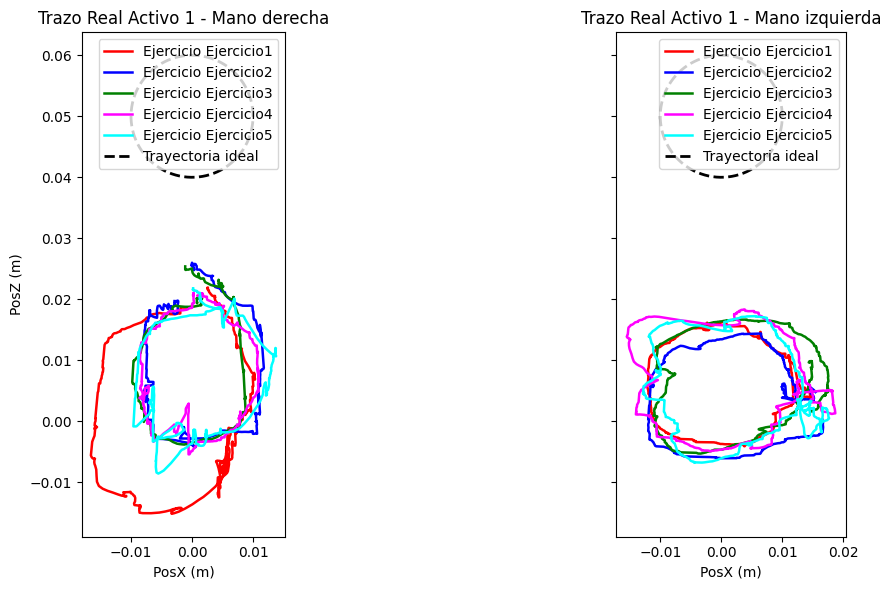

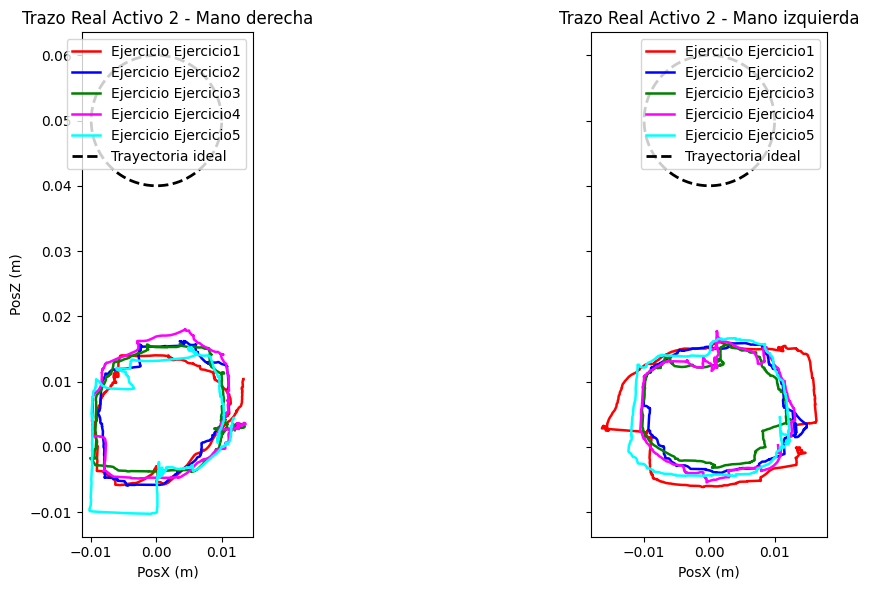

In [87]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

# === CONFIGURACIÓN GENERAL ===
data_path = "C:/TIC_JE/Activos/realData"
colores = ['red', 'blue', 'green', 'magenta', 'cyan']
radio_ideal = 0.010  # 1.5 cm en metros

# === FUNCIONES ===

def cargar_trayectorias(nombre_archivo):
    df = pd.read_csv(os.path.join(data_path, nombre_archivo))
    
    trayectorias = []
    if 'Etiqueta' not in df.columns:
        raise ValueError("El archivo debe tener una columna llamada 'Etiqueta'")
    
    for i, ejercicio in enumerate(sorted(df['Etiqueta'].unique())):
        df_ej = df[df['Etiqueta'] == ejercicio]
        posx = df_ej['pxr_01']/1000  # o pxi_01 si es izquierda
        posz = df_ej['pzr_01']/1000
        trayectorias.append((posx, posz, colores[i], f"Ejercicio {ejercicio}"))
    return trayectorias

def dibujar_circulo(ax, centro=(0, 0.05), radio=radio_ideal, color='black', estilo='--', label='Trayectoria ideal'):
    angulos = np.linspace(0, 2 * np.pi, 100)
    x = centro[0] + radio * np.cos(angulos)
    z = centro[1] + radio * np.sin(angulos)
    ax.plot(x, z, linestyle=estilo, color=color, linewidth=2, label=label)

def graficar_trayectorias(t_der, t_izq, titulo):
    fig, axs = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

    # Mano derecha
    axs[0].set_title(f"{titulo} - Mano derecha")
    for x, z, color, etiqueta in t_der:
        axs[0].plot(x, z, color=color, linewidth=1.8, label=etiqueta)
    dibujar_circulo(axs[0], centro=(0,0.05))
    axs[0].set_xlabel("PosX (m)")
    axs[0].set_ylabel("PosZ (m)")
    axs[0].set_aspect('equal')
    axs[0].legend(loc='upper right')

    # Mano izquierda
    axs[1].set_title(f"{titulo} - Mano izquierda")
    for x, z, color, etiqueta in t_izq:
        axs[1].plot(x, z, color=color, linewidth=1.8, label=etiqueta)
    dibujar_circulo(axs[1])
    axs[1].set_xlabel("PosX (m)")
    axs[1].set_aspect('equal')
    axs[1].legend(loc='upper right')

    plt.tight_layout()
    plt.show()

# === CARGAR DATOS Y GRAFICAR ACTIVO 1 ===
trayectorias_der_1 = cargar_trayectorias("activos1_derecha.csv")
trayectorias_izq_1 = cargar_trayectorias("activos1_izquierda.csv")
graficar_trayectorias(trayectorias_der_1, trayectorias_izq_1, "Trazo Real Activo 1")

# === CARGAR DATOS Y GRAFICAR ACTIVO 2 ===
trayectorias_der_2 = cargar_trayectorias("activos2_derecha.csv")
trayectorias_izq_2 = cargar_trayectorias("activos2_izquierda.csv")
graficar_trayectorias(trayectorias_der_2, trayectorias_izq_2, "Trazo Real Activo 2")


### 2.2 Instanciar el preprocesor

El módulo `preprocessor.py` manejará la carga, limpieza e interpolación de cada ejercicio.

In [3]:
from preprocessor import TimeGANPreprocessor
preprocessor = TimeGANPreprocessor(config)
processed_data = {}

In [4]:
for dataset_name, info in available_data.items():
    print(f"\n🔄 PROCESANDO {dataset_name.upper()}")
    print("="*60)
    
    processed_exercises = {}
    
    for exercise in info['exercises']:
        try:
            # Procesar ejercicio individual
            exercise_data = preprocessor.process_single_exercise(
                info['filepath'], 
                exercise
            )
            processed_exercises[exercise] = exercise_data
            
            print(f"   ✅ {exercise}: Shape {exercise_data.shape}")
            
        except Exception as e:
            print(f"   ❌ {exercise}: Error - {e}")
            continue
    
    if processed_exercises:
        processed_data[dataset_name] = processed_exercises
        print(f"\n📈 {dataset_name}: {len(processed_exercises)} ejercicios procesados exitosamente")


🔄 PROCESANDO ACTIVOS1_DERECHA

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1256 puntos
   • Después de limpieza: 1256 puntos
   📐 Rangos de posición: [26.663  4.069 36.577]
   🏃 Rangos de velocidad: [24.612  8.479 20.703]
   📊 Variabilidad espacial: 22.436
   ✅ Ejercicio1: Shape (200, 6)

🏃 PROCESANDO Ejercicio2
📊 Cargando Ejercicio2…
   • Datos originales: 1886 puntos
   • Después de limpieza: 1886 puntos
   📐 Rangos de posición: [19.632  3.803 28.931]
   🏃 Rangos de velocidad: [10.675  3.233 21.056]
   📊 Variabilidad espacial: 17.456
   ✅ Ejercicio2: Shape (200, 6)

🏃 PROCESANDO Ejercicio3
📊 Cargando Ejercicio3…
   • Datos originales: 928 puntos
   • Después de limpieza: 928 puntos
   📐 Rangos de posición: [18.641  2.346 28.912]
   🏃 Rangos de velocidad: [22.698  7.496 17.899]
   📊 Variabilidad espacial: 16.633
   ✅ Ejercicio3: Shape (200, 6)

🏃 PROCESANDO Ejercicio4
📊 Cargando Ejercicio4…
   • Datos originales: 1122 puntos
   • Después de limpieza: 1122 pu

### 2.3 Visualización de Datos Preprocesados

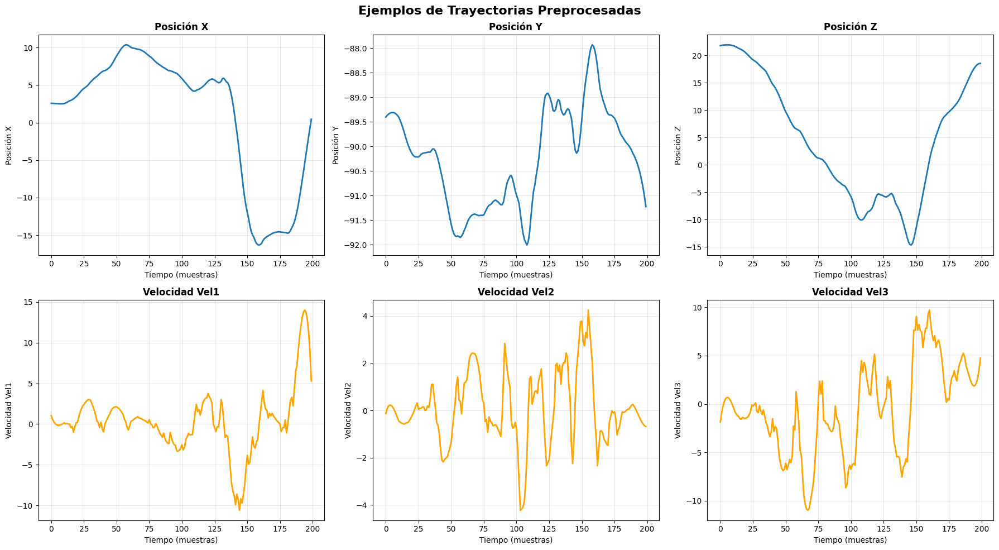

📊 Ejemplo mostrado: activos1_derecha - Ejercicio1
📁 Gráfico guardado en: C:\TIC_JE\Activos\timeGan\images\preprocessed_data_example.png


In [5]:
# Visualizar ejemplos de datos preprocesados
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
fig.suptitle('Ejemplos de Trayectorias Preprocesadas', fontsize=16, fontweight='bold')

# Tomar el primer dataset y ejercicio disponible
if processed_data:
    first_dataset = list(processed_data.keys())[0]
    first_exercise = list(processed_data[first_dataset].keys())[0]
    sample_data = processed_data[first_dataset][first_exercise]
    
    time_axis = np.arange(config.SEQ_LEN)
    
    # Posiciones
    for i, (dim, label) in enumerate(zip([0, 1, 2], ['X', 'Y', 'Z'])):
        axes[0, i].plot(time_axis, sample_data[:, dim], linewidth=2)
        axes[0, i].set_title(f'Posición {label}', fontweight='bold')
        axes[0, i].set_xlabel('Tiempo (muestras)')
        axes[0, i].set_ylabel(f'Posición {label}')
        axes[0, i].grid(True, alpha=0.3)
    
    # Velocidades
    for i, (dim, label) in enumerate(zip([3, 4, 5], ['Vel1', 'Vel2', 'Vel3'])):
        axes[1, i].plot(time_axis, sample_data[:, dim], linewidth=2, color='orange')
        axes[1, i].set_title(f'Velocidad {label}', fontweight='bold')
        axes[1, i].set_xlabel('Tiempo (muestras)')
        axes[1, i].set_ylabel(f'Velocidad {label}')
        axes[1, i].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(config.IMG_DIR / 'preprocessed_data_example.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"📊 Ejemplo mostrado: {first_dataset} - {first_exercise}")
    print(f"📁 Gráfico guardado en: {config.IMG_DIR / 'preprocessed_data_example.png'}")

## 3. Modelo generativo

### 3.1 Configuración del modelo

Se define la clase *TimeGANConfig* en el módulo aparte `config.py` para mantener el notebook limpio. Esta clase centraliza todos los hiperparámetros y rutas de salida.

In [6]:
# Inicializar configuración
from config import TimeGANConfig
config = TimeGANConfig()

# 1) Definimos la carpeta syntheticData al nivel del proyecto
config.PEXERCISE_DIR.mkdir(parents=True, exist_ok=True)
config.PPATIENT_DIR.mkdir(parents=True, exist_ok=True)

print("🎯 CONFIGURACIÓN DEL MODELO TIMEGAN")
print("="*90)
print(f"📊 Características de entrada: {config.FEATURE_COLS}")
print(f"📏 Longitud de secuencia temporal: {config.SEQ_LEN}")
print(f"🧠 Dimensión oculta por capas: {config.HIDDEN_DIM}")
print(f"🧠 Número de capas en cada red: {config.NUM_LAYERS}")
print(f"🎲 Dimensión del vector de ruido aleatorio: {config.NOISE_DIM}")
print(f"🔄 Épocas entrenamiento: {config.EPOCHS}")
print(f"📦 Batch size: {config.BATCH_SIZE}")
print(f"🎯 Device: {config.DEVICE}")

🎯 CONFIGURACIÓN DEL MODELO TIMEGAN
📊 Características de entrada: ['pxr_01', 'pyr_01', 'pzr_01', 'vel1_01', 'vel2_01', 'vel3_01']
📏 Longitud de secuencia temporal: 200
🧠 Dimensión oculta por capas: 160
🧠 Número de capas en cada red: 3
🎲 Dimensión del vector de ruido aleatorio: 96
🔄 Épocas entrenamiento: 250
📦 Batch size: 1
🎯 Device: cpu


### 3.2 Arquitectura del modelo

Se establece el módulo `models.py` para contener a la arquitectura con diferentes componentes que trabajan en conjunto.

#### 3.2.1 Bloque temporal con mecanismo de atención

Clase que captura dependencias complejas en secuencias de movimiento.

In [7]:
from models import TemporalBlock

#### 3.2.2 Componentes de TimeGan

- **Embedder (E):**
Codifica la serie real de dimensión D→hidden_dim, capturando patrones temporales y físicos.
   - Codifica secuencias reales en espacio latente
   - LSTM + Atención temporal
   - Input: Datos reales → Output: Representación latente

- **Recovery (R):**
Decodifica el espacio latente de vuelta a dimensión D, garantizando fidelidad al espacio original.
   - Decodifica representaciones latentes a secuencias
   - LSTM + Capas fully connected
   - Input: Representación latente → Output: Secuencia reconstruida

- **Generator (G):**
Transforma ruido (secuencia de vectores z) en un embedding latente que imita la estructura de los datos reales.
   - Genera representaciones latentes desde ruido
   - LSTM + Bloques de atención
   - Input: Ruido aleatorio → Output: Representación latente sintética

- **Supervisor (S):**
Refuerza la consistencia temporal del embedding generado, prediciendo pasos futuros en la serie.
   - Asegura consistencia temporal
   - LSTM para transiciones temporales
   - Input: Representación latente → Output: Siguiente paso temporal

- **Discriminator (D):**
Clasifica embeddings reales vs. sintéticos, forzando al generador a mejorar la calidad.
   - Distingue entre secuencias reales y sintéticas
   - LSTM + Clasificador
   - Input: Representación latente → Output: Probabilidad de ser real

In [8]:
from models import Embedder, Recovery, Generator, Supervisor, Discriminator

#### 3.2.3 Flujo de entrenamiento

Real Data → E → H_real → R → X_reconstructed

Noise → G → E_hat → S → H_hat → R → X_synthetic

↓

D → Real/Fake

#### 3.2.4 Instanciación de modelos

In [9]:
# Crear todos los modelos
from models import create_models
models = create_models(config)

print("\n🏗️ MODELOS CREADOS:")
print("-" * 40)
for name, model in models.items():
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"{name:>12}: {total_params:>8,} parámetros ({trainable_params:>8,} entrenables)")

total_all = sum(p.numel() for model in models.values() for p in model.parameters())
print(f"{'TOTAL':>12}: {total_all:>8,} parámetros")

✅ Modelos creados - Total parámetros: 4,598,807

🏗️ MODELOS CREADOS:
----------------------------------------
           E: 1,045,200 parámetros (1,045,200 entrenables)
           R: 1,044,726 parámetros (1,044,726 entrenables)
           G: 1,052,400 parámetros (1,052,400 entrenables)
           S:  618,720 parámetros ( 618,720 entrenables)
           D:  837,761 parámetros ( 837,761 entrenables)
       TOTAL: 4,598,807 parámetros


## 4. Entrenamiento de Modelos

### 4.1 Funciones de Pérdida

Para guiar el entrenamiento hacia trayectorias realistas y diversas, se definen cuatro componentes de pérdida en el módulo `losses.py`:

- **Reconstrucción (E→R):**  
  Mezcla L₁ + ½·L₂ para preservar detalles sin sobrepenalizar errores grandes.

- **Consistencia temporal:**  
  Penaliza cambios bruscos de velocidad y aceleración para asegurar suavidad.

- **Coherencia física:**  
  Verifica que la velocidad “dada” por el dataset coincida con la velocidad derivada de la posición.

- **Diversidad intra-batch:**  
  Minimiza la similitud coseno entre muestras en el mismo batch, promoviendo variedad.

In [10]:
from losses import TimeGANLosses

### 4.2 Configuración de Entrenamiento

In [11]:
# Configurar entrenamiento para cada dataset/ejercicio
training_configs = []

for dataset_name, exercises in processed_data.items():
    for exercise_name, exercise_data in exercises.items():
        training_config = {
            'dataset_name': dataset_name,
            'exercise_name': exercise_name,
            'data': exercise_data,
            'model_name': f"{dataset_name}_{exercise_name}",
            'checkpoint_path': config.CKPT_DIR / f"{dataset_name}_{exercise_name}.pt"
        }
        training_configs.append(training_config)

print(f"📋 CONFIGURACIONES DE ENTRENAMIENTO PREPARADAS:")
print(f"   Total modelos a entrenar: {len(training_configs)}")
for i, cfg in enumerate(training_configs, 1):
    print(f"   {i:2d}. {cfg['model_name']} (Shape: {cfg['data'].shape})")

📋 CONFIGURACIONES DE ENTRENAMIENTO PREPARADAS:
   Total modelos a entrenar: 20
    1. activos1_derecha_Ejercicio1 (Shape: (200, 6))
    2. activos1_derecha_Ejercicio2 (Shape: (200, 6))
    3. activos1_derecha_Ejercicio3 (Shape: (200, 6))
    4. activos1_derecha_Ejercicio4 (Shape: (200, 6))
    5. activos1_derecha_Ejercicio5 (Shape: (200, 6))
    6. activos1_izquierda_Ejercicio1 (Shape: (200, 6))
    7. activos1_izquierda_Ejercicio2 (Shape: (200, 6))
    8. activos1_izquierda_Ejercicio3 (Shape: (200, 6))
    9. activos1_izquierda_Ejercicio4 (Shape: (200, 6))
   10. activos1_izquierda_Ejercicio5 (Shape: (200, 6))
   11. activos2_derecha_Ejercicio1 (Shape: (200, 6))
   12. activos2_derecha_Ejercicio2 (Shape: (200, 6))
   13. activos2_derecha_Ejercicio3 (Shape: (200, 6))
   14. activos2_derecha_Ejercicio4 (Shape: (200, 6))
   15. activos2_derecha_Ejercicio5 (Shape: (200, 6))
   16. activos2_izquierda_Ejercicio1 (Shape: (200, 6))
   17. activos2_izquierda_Ejercicio2 (Shape: (200, 6))
   18.

### 4.3 Lógica de entrenamiento

Se encapsula la lógica en el módulo `trainer.py` de entrenamiento en una clase que:

- Gestiona tres optimizadores (E/R, G/S, D) con *CosineAnnealing*.
- Implementa WGAN-GP (gradient penalty) para estabilizar el discriminador.
- Alterna pasos de D y pasos de G según configuración.
- Incluye pre-entrenamiento de autoencoder E→R.
- Registra historial de pérdidas y aplicamos early-stopping basado en un score combinado.
- Permite guardar y recargar checkpoints fácilmente.

In [12]:
from trainer import TimeGANTrainer

### 4.4 Función de prueba: `test_balanced_config`


Esta función fue utilizada durante la fase de experimentación para evaluar una configuración balanceada del modelo TimeGAN. Permite entrenar con menos épocas y generar muestras sintéticas usando estrategias específicas. Se utilizó para comparar resultados antes de definir la configuración final.

🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1256 puntos
   • Después de limpieza: 1256 puntos
   📐 Rangos de posición: [26.663  4.069 36.577]
   🏃 Rangos de velocidad: [24.612  8.479 20.703]
   📊 Variabilidad espacial: 22.436
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.2562
   Epoch 15: Loss 3.0561
   Epoch 30: Loss 2.5163
📚 Pre-entrenamiento supervisor balanceado...
   Epoch 0: Loss 2.1415
   Epoch 15: Loss 0.5547
   Epoch 30: Loss 0.2502
⚔️ Entrenamiento adversarial balanceado...
   Epoch 0: D=9.5597, G=4.5671
   Epoch 30: D=9.8802, G=2.6024
   Epoch 60: D=9.4318, G=2.1811
   Epoch 90: D=9.8112, G=1.6403
📊 Evaluación mejorada guardada: C:\TIC_JE\Activos\timeGan\checkpoints\enhanced_evaluation_Ejercicio1_balanced_test.png


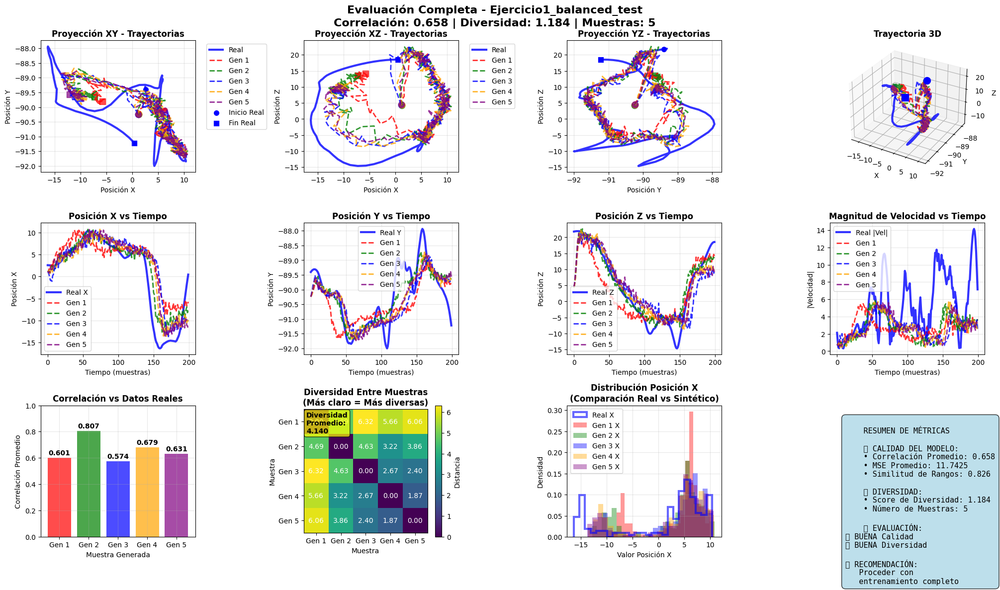

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.658       | 1.184      | 0.921
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ✅ BUEN balance alcanzado
   ✅ Correlación: 0.658
   ⚠️ Diversidad: 1.184
   📊 Score balance: 0.921
   👍 ACEPTABLE PARA TESIS


In [16]:
from trainer import test_balanced_config
result = test_balanced_config(config, r"C:\TIC_JE\Activos\realData\activos1_derecha.csv", "Ejercicio1")

### 4.5 Función de entrenamiento final


🚀 ENTRENANDO MODELO FINAL PARA activos1_derecha_Ejercicio1

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1256 puntos
   • Después de limpieza: 1256 puntos
   📐 Rangos de posición: [26.663  4.069 36.577]
   🏃 Rangos de velocidad: [24.612  8.479 20.703]
   📊 Variabilidad espacial: 22.436
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

📚 Pre-entrenamiento Autoencoder (100 epochs)
   Epoch 0: AE Loss = 3.2328
   Epoch 30: AE Loss = 2.6193
   Epoch 60: AE Loss = 1.9832
   Epoch 90: AE Loss = 1.8613

📚 Pre-entrenamiento Supervisor (100 epochs)
   Epoch 0: S Loss = 2.0684
   Epoch 30: S Loss = 0.2748
   Epoch 60: S Loss = 0.1641
   Epoch 90: S Loss = 0.1436

⚔️ Entrenamiento Adversarial Final (250 epochs)
   Epoch 0: D=9.7703, G=4.7762
   Epoch 50: D=10.0377, G=2.1006
   Epoch 100: D=9.1345, G=1.2712
   Epoch 150: D=8.2964, G=0.6690
   Epoch 200: D=9.4717, G=0.0396
💾 Nuevo mejor modelo guardado!


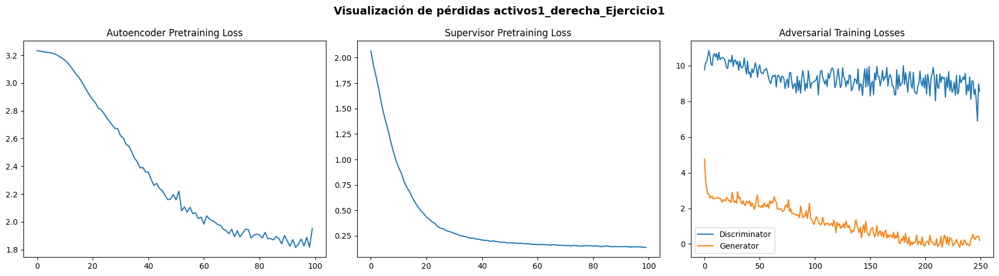

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio1.png


In [19]:
from trainer import train_model
trainer, preprocessor, data, data_normalized = train_model(
                                                config=config,
                                                filepath=r"C:\TIC_JE\Activos\realData\activos1_derecha.csv",
                                                activo="activos1",
                                                mano="derecha",
                                                ejercicio="Ejercicio1"
                                              )

## 5. Generación de datos


🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.719
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.720
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 127
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.719
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 456
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Realismo: 0.718
      🎭 Diversidad: 1.000
      🎯 Score final: 0.915
      🔄 Intentos: 409
      🛠️ Estrategia: 

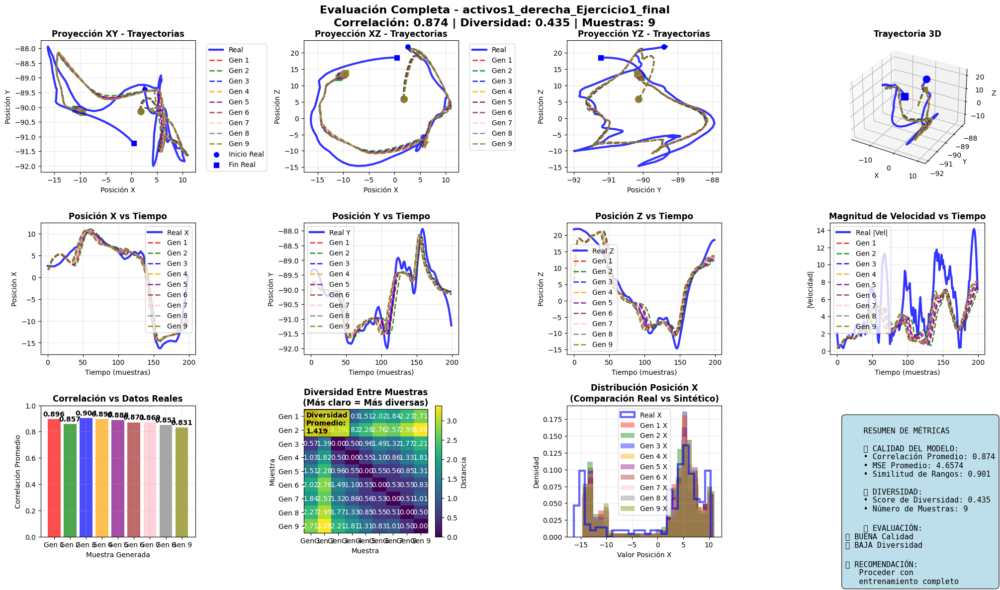

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio1.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente1_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente2_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente3_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente4_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente5_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente6_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente7_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Acti

In [22]:
from generator import DiverseDataGenerator, generate_outputs
generate_outputs(
    config=config,
    trainer=trainer,  # se cargará automáticamente desde el .pt
    preprocessor=preprocessor,
    data_normalized=data_normalized,  # se puede recalcular si es necesario
    activo="activos1",
    mano="derecha",
    ejercicio="Ejercicio1",
    n_pacientes=9
)


## 6. Función masiva de entrenamiento y generación de datos


🚀 Procesando: activos1_derecha_Ejercicio1
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1256 puntos
   • Después de limpieza: 1256 puntos
   📐 Rangos de posición: [26.663  4.069 36.577]
   🏃 Rangos de velocidad: [24.612  8.479 20.703]
   📊 Variabilidad espacial: 22.436
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.2637
   Epoch 15: Loss 3.0985
   Epoch 30: Loss 2.5477
📚 Pre-entrenamiento supervisor balanceado...
   Epoch 0: Loss 2.0172
   Epoch 15: Loss 0.5418
   Epoch 30: Loss 0.2542
⚔️ Entrenamiento adversarial balanceado...
   Epoch 0: D=10.3336, G=4.6777
   Epoch 30: D=9.7119, G=2.2948
   Epoch 60: D=9.7318, G=1.7505
   Epoch 90: D=9.1557, G=1.3780
📊 Evaluación mejorada guardada: C:\TIC_JE\Activos\timeGan\checkpoints\enhanced_evaluation_

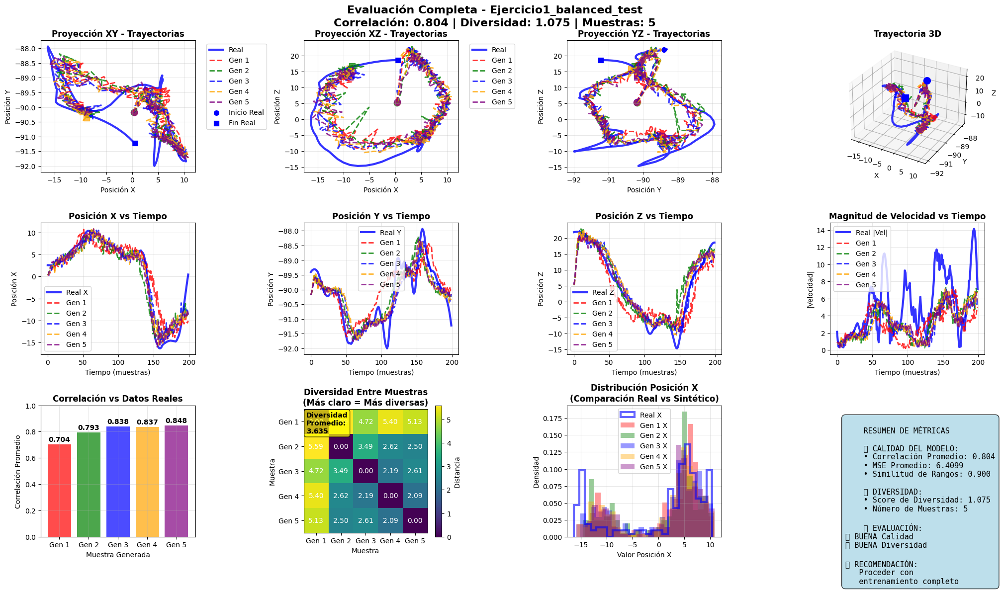

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.804       | 1.075      | 0.940
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.804 > 0.70
   ✅ Diversidad: 1.075 > 0.55
   ✅ Score balance: 0.940
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.804, Div=1.075

🚀 Procesando: activos1_derecha_Ejercicio2
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio2
📊 Cargando Ejercicio2…
   • Datos originales: 1886 puntos
   • Después de limpieza: 1886 puntos
   📐 Rangos de posición: [19.632  3.803 28.931]
   🏃 Rangos de velocidad: [10.675  3.233 21.056]
   📊 Variabilidad espacial: 17.456
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epo

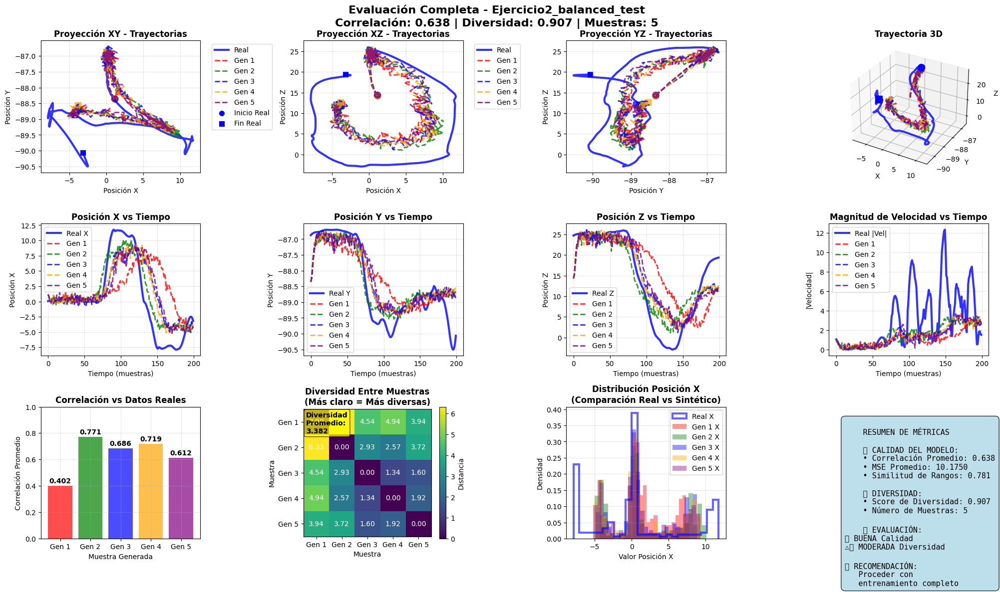

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.638       | 0.907      | 0.772
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ⚠️ Balance necesita ajuste
   📊 Continuar experimentando con parámetros
   ✅ ÉXITO: Corr=0.638, Div=0.907

🚀 Procesando: activos1_derecha_Ejercicio3
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio3
📊 Cargando Ejercicio3…
   • Datos originales: 928 puntos
   • Después de limpieza: 928 puntos
   📐 Rangos de posición: [18.641  2.346 28.912]
   🏃 Rangos de velocidad: [22.698  7.496 17.899]
   📊 Variabilidad espacial: 16.633
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3293
   Epoch 15: Loss 3.1182
   Epoch 30: Loss 2.5757
📚 Pre-entrenamient

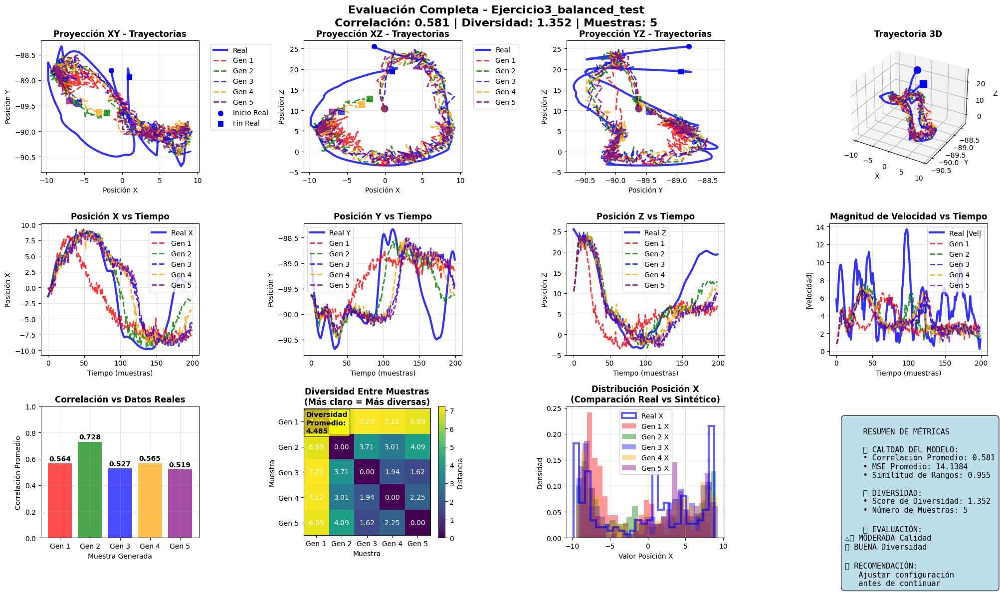

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.581       | 1.352      | 0.966
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ⚠️ Balance necesita ajuste
   📊 Continuar experimentando con parámetros
   ❌ FALLO: Calidad insuficiente

🚀 Procesando: activos1_derecha_Ejercicio4
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio4
📊 Cargando Ejercicio4…
   • Datos originales: 1122 puntos
   • Después de limpieza: 1122 puntos
   📐 Rangos de posición: [19.459  3.182 25.669]
   🏃 Rangos de velocidad: [13.42   5.601 19.458]
   📊 Variabilidad espacial: 16.104
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3490
   Epoch 15: Loss 3.0125
   Epoch 30: Loss 2.5133
📚 Pre-entrenamien

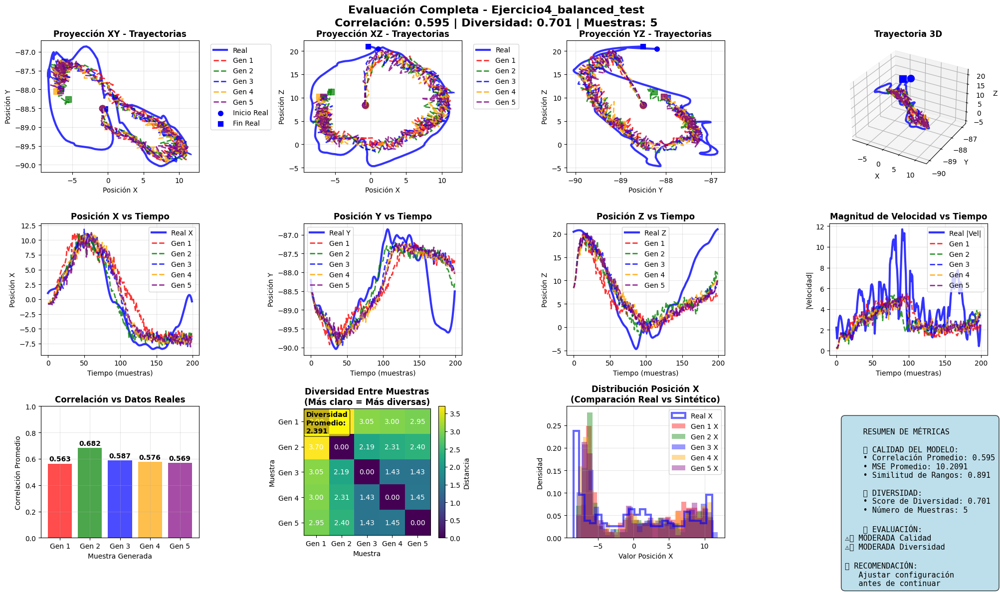

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.595       | 0.701      | 0.648
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ⚠️ Balance necesita ajuste
   📊 Continuar experimentando con parámetros
   ❌ FALLO: Calidad insuficiente

🚀 Procesando: activos1_derecha_Ejercicio5
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio5
📊 Cargando Ejercicio5…
   • Datos originales: 1046 puntos
   • Después de limpieza: 1046 puntos
   📐 Rangos de posición: [23.42   2.204 26.815]
   🏃 Rangos de velocidad: [23.088  4.413 24.367]
   📊 Variabilidad espacial: 17.480
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3359
   Epoch 15: Loss 3.1142
   Epoch 30: Loss 2.6103
📚 Pre-entrenamien

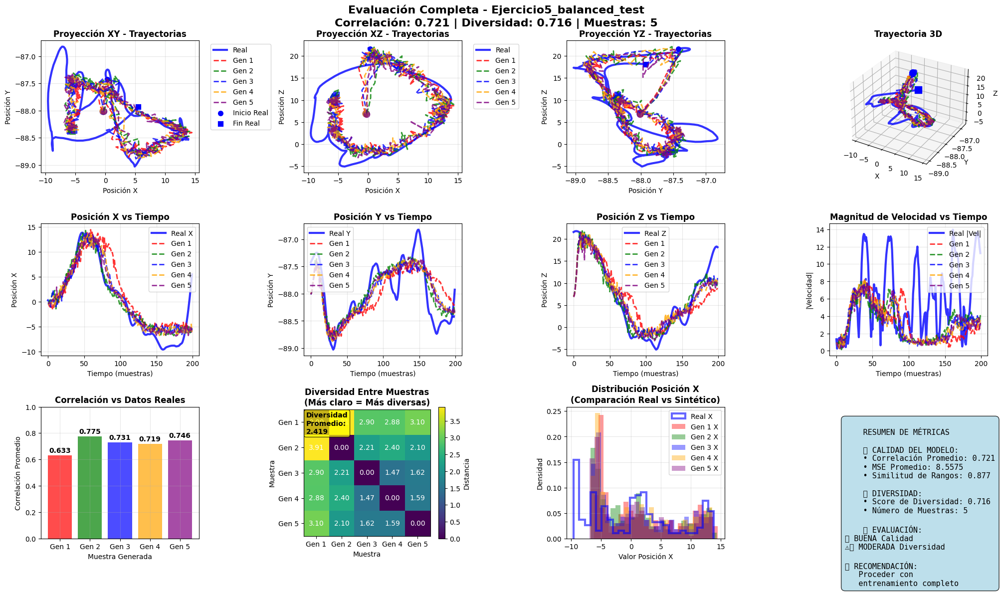

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.721       | 0.716      | 0.718
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.721 > 0.70
   ✅ Diversidad: 0.716 > 0.55
   ✅ Score balance: 0.718
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.721, Div=0.716

🚀 Procesando: activos1_izquierda_Ejercicio1
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1186 puntos
   • Después de limpieza: 1186 puntos
   📐 Rangos de posición: [26.452  2.439 19.587]
   🏃 Rangos de velocidad: [21.472  6.716 15.589]
   📊 Variabilidad espacial: 16.159
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

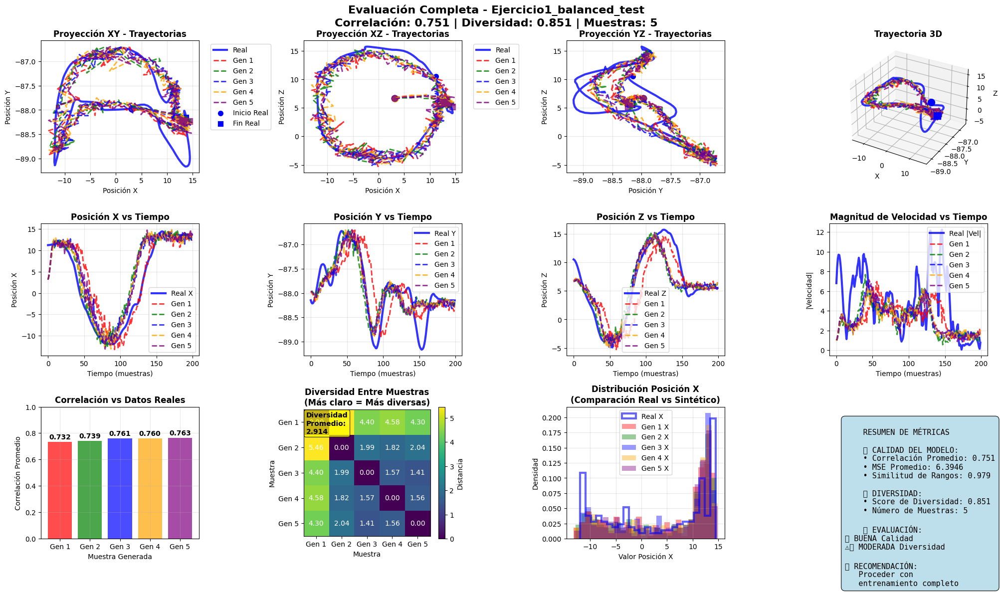

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.751       | 0.851      | 0.801
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.751 > 0.70
   ✅ Diversidad: 0.851 > 0.55
   ✅ Score balance: 0.801
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.751, Div=0.851

🚀 Procesando: activos1_izquierda_Ejercicio2
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio2
📊 Cargando Ejercicio2…
   • Datos originales: 1127 puntos
   • Después de limpieza: 1127 puntos
   📐 Rangos de posición: [29.028  3.012 20.437]
   🏃 Rangos de velocidad: [23.979  7.354 22.297]
   📊 Variabilidad espacial: 17.492
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

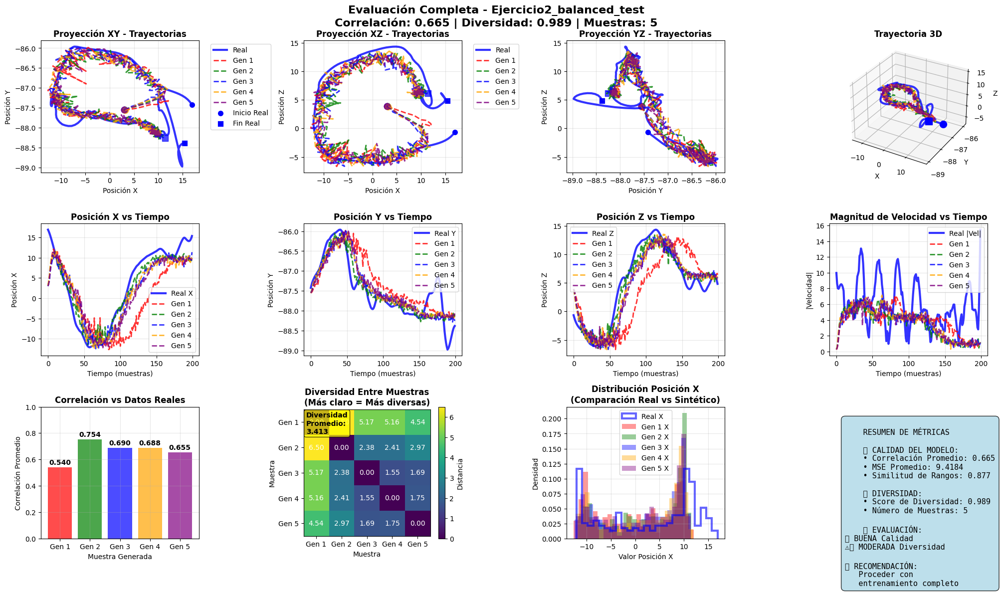

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.665       | 0.989      | 0.827
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ✅ BUEN balance alcanzado
   ✅ Correlación: 0.665
   ⚠️ Diversidad: 0.989
   📊 Score balance: 0.827
   👍 ACEPTABLE PARA TESIS
   ✅ ÉXITO: Corr=0.665, Div=0.989

🚀 Procesando: activos1_izquierda_Ejercicio3
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio3
📊 Cargando Ejercicio3…
   • Datos originales: 1369 puntos
   • Después de limpieza: 1369 puntos
   📐 Rangos de posición: [28.546  5.861 21.849]
   🏃 Rangos de velocidad: [19.711 10.227 12.6  ]
   📊 Variabilidad espacial: 18.752
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.2918
   Epoch 15

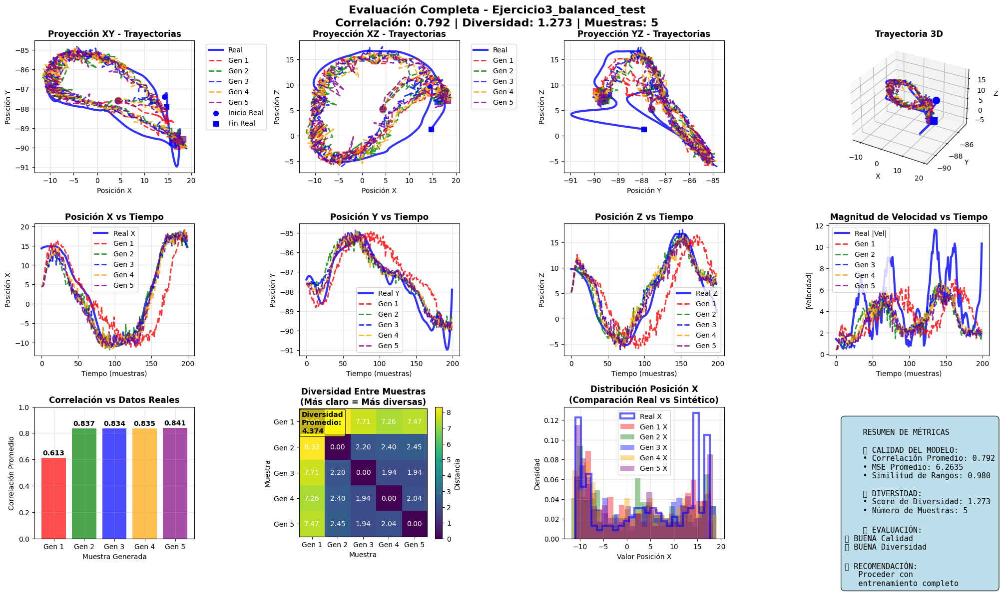

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.792       | 1.273      | 1.032
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.792 > 0.70
   ✅ Diversidad: 1.273 > 0.55
   ✅ Score balance: 1.032
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.792, Div=1.273

🚀 Procesando: activos1_izquierda_Ejercicio4
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio4
📊 Cargando Ejercicio4…
   • Datos originales: 1391 puntos
   • Después de limpieza: 1391 puntos
   📐 Rangos de posición: [33.701  3.665 23.017]
   🏃 Rangos de velocidad: [25.749  5.656 18.247]
   📊 Variabilidad espacial: 20.128
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

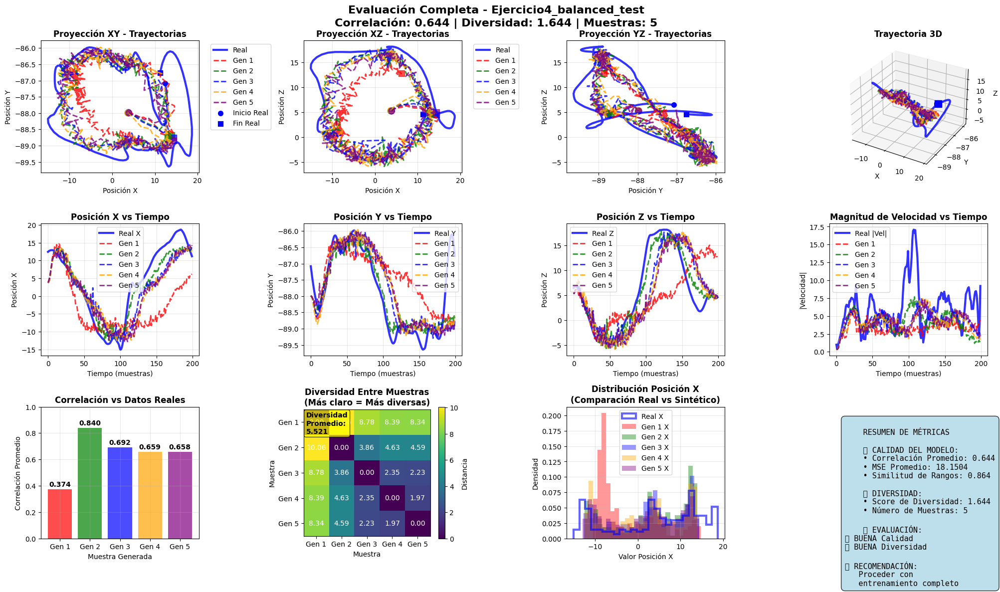

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.644       | 1.644      | 1.144
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ⚠️ Balance necesita ajuste
   📊 Continuar experimentando con parámetros
   ✅ ÉXITO: Corr=0.644, Div=1.644

🚀 Procesando: activos1_izquierda_Ejercicio5
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio5
📊 Cargando Ejercicio5…
   • Datos originales: 1591 puntos
   • Después de limpieza: 1591 puntos
   📐 Rangos de posición: [29.153  2.825 23.28 ]
   🏃 Rangos de velocidad: [26.907  4.733 14.626]
   📊 Variabilidad espacial: 18.419
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3100
   Epoch 15: Loss 3.0369
   Epoch 30: Loss 2.4432
📚 Pre-entrenam

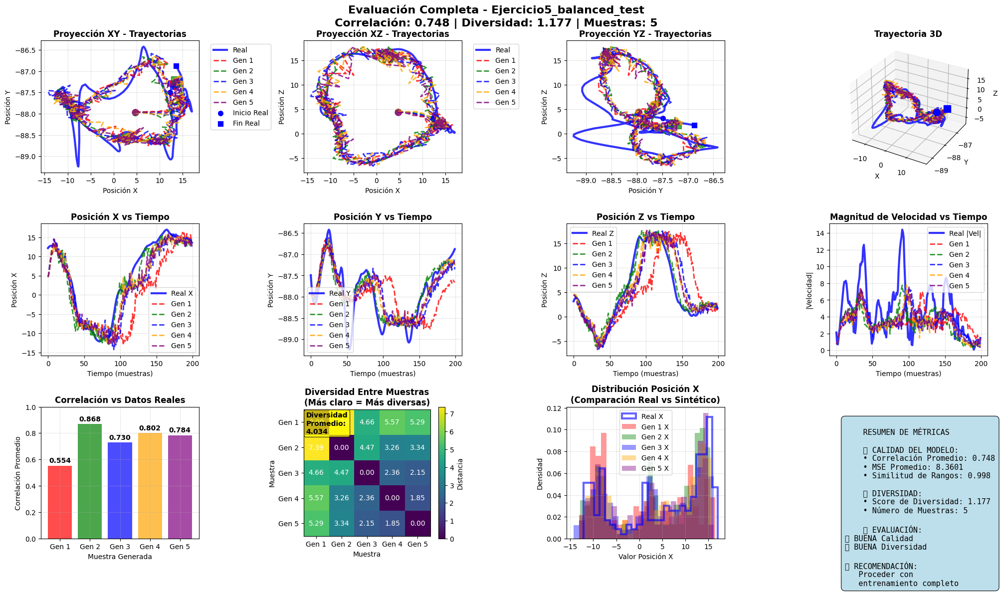

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.748       | 1.177      | 0.963
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.748 > 0.70
   ✅ Diversidad: 1.177 > 0.55
   ✅ Score balance: 0.963
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.748, Div=1.177

🚀 Procesando: activos2_derecha_Ejercicio1
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1091 puntos
   • Después de limpieza: 1091 puntos
   📐 Rangos de posición: [22.889  2.851 19.536]
   🏃 Rangos de velocidad: [20.237  4.581 15.087]
   📊 Variabilidad espacial: 15.092
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epo

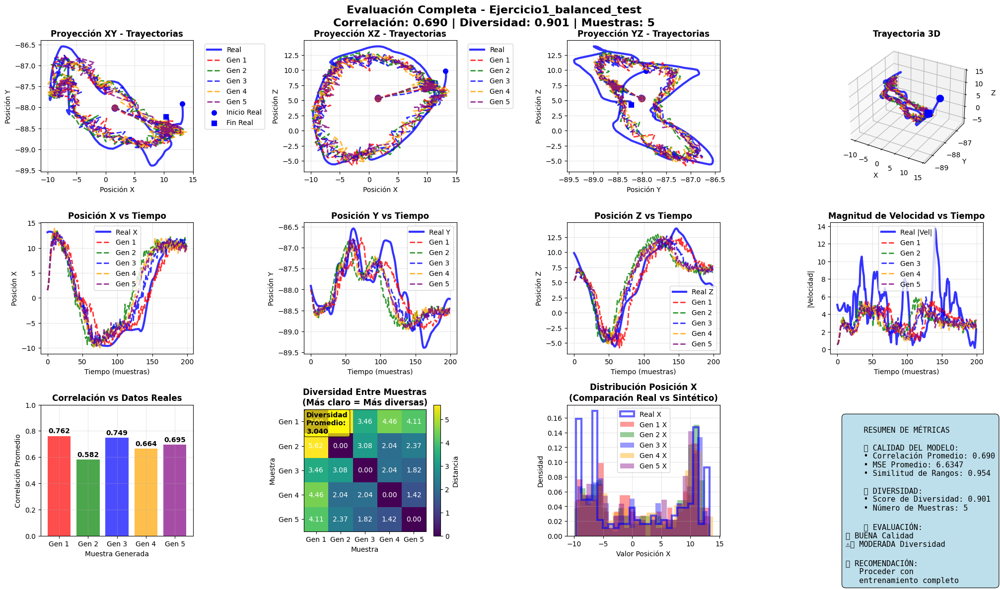

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.690       | 0.901      | 0.796
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ✅ BUEN balance alcanzado
   ✅ Correlación: 0.690
   ⚠️ Diversidad: 0.901
   📊 Score balance: 0.796
   👍 ACEPTABLE PARA TESIS
   ✅ ÉXITO: Corr=0.690, Div=0.901

🚀 Procesando: activos2_derecha_Ejercicio2
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio2
📊 Cargando Ejercicio2…
   • Datos originales: 1187 puntos
   • Después de limpieza: 1187 puntos
   📐 Rangos de posición: [20.147  2.185 22.002]
   🏃 Rangos de velocidad: [16.106  3.597 13.749]
   📊 Variabilidad espacial: 14.778
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3605
   Epoch 15: 

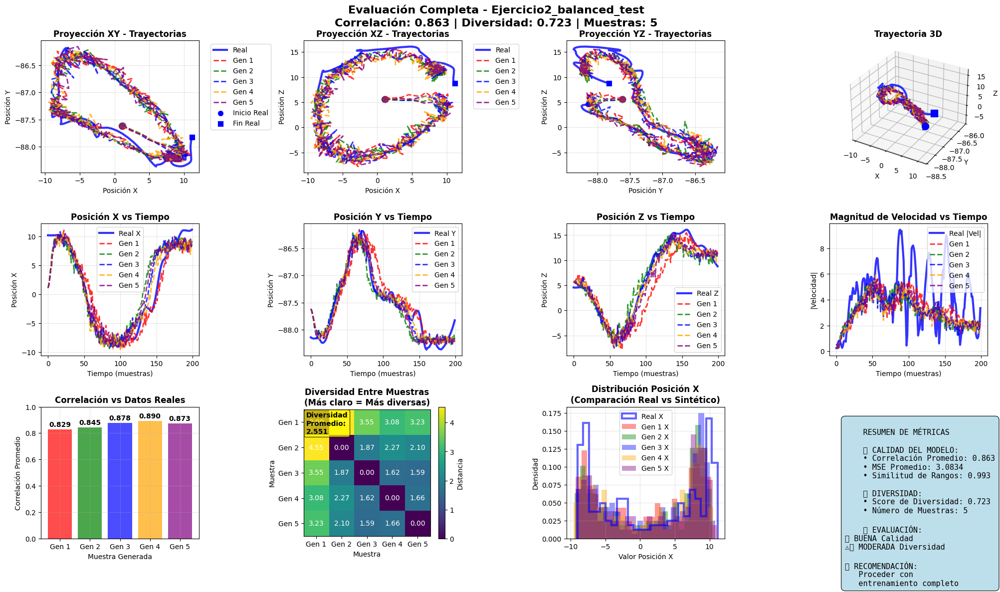

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.863       | 0.723      | 0.793
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.863 > 0.70
   ✅ Diversidad: 0.723 > 0.55
   ✅ Score balance: 0.793
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.863, Div=0.723

🚀 Procesando: activos2_derecha_Ejercicio3
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio3
📊 Cargando Ejercicio3…
   • Datos originales: 1642 puntos
   • Después de limpieza: 1642 puntos
   📐 Rangos de posición: [21.664  3.656 19.443]
   🏃 Rangos de velocidad: [18.94   4.417 14.466]
   📊 Variabilidad espacial: 14.921
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epo

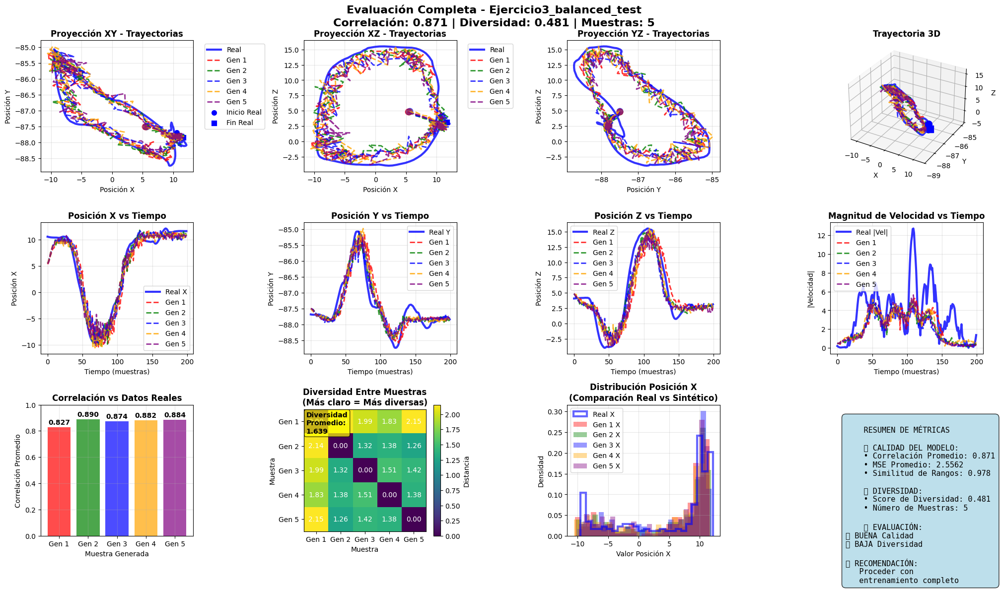

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.871       | 0.481      | 0.676
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ✅ BUEN balance alcanzado
   ✅ Correlación: 0.871
   ⚠️ Diversidad: 0.481
   📊 Score balance: 0.676
   👍 ACEPTABLE PARA TESIS
   ✅ ÉXITO: Corr=0.871, Div=0.481

🚀 Procesando: activos2_derecha_Ejercicio4
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio4
📊 Cargando Ejercicio4…
   • Datos originales: 1395 puntos
   • Después de limpieza: 1395 puntos
   📐 Rangos de posición: [22.802  3.688 22.238]
   🏃 Rangos de velocidad: [18.533  4.809 14.612]
   📊 Variabilidad espacial: 16.243
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epoch 0: Loss 3.3282
   Epoch 15: 

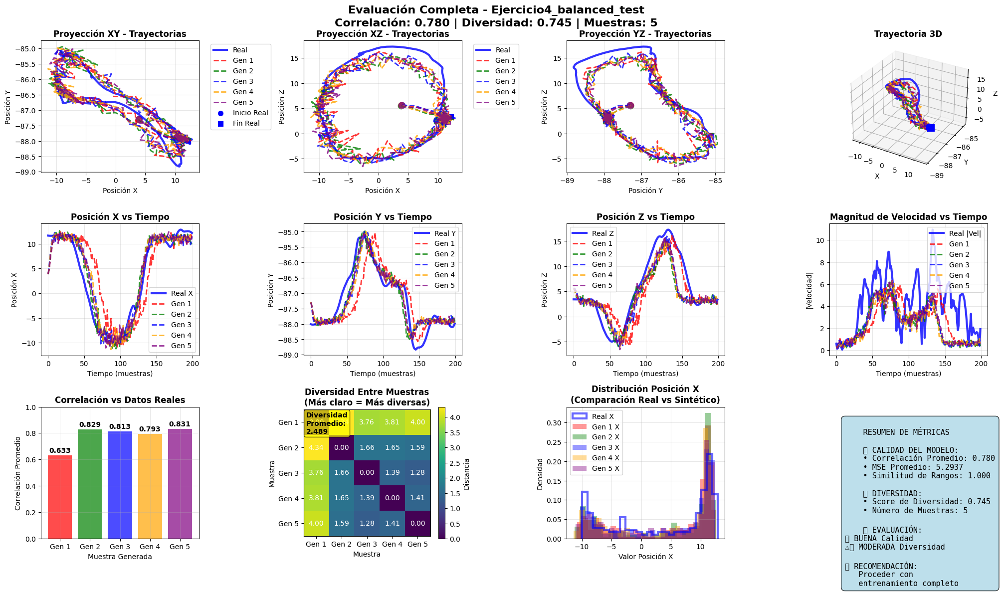

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.780       | 0.745      | 0.763
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.780 > 0.70
   ✅ Diversidad: 0.745 > 0.55
   ✅ Score balance: 0.763
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.780, Div=0.745

🚀 Procesando: activos2_derecha_Ejercicio5
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio5
📊 Cargando Ejercicio5…
   • Datos originales: 1504 puntos
   • Después de limpieza: 1504 puntos
   📐 Rangos de posición: [22.461  2.575 23.823]
   🏃 Rangos de velocidad: [20.227  5.819 11.504]
   📊 Variabilidad espacial: 16.286
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   Epo

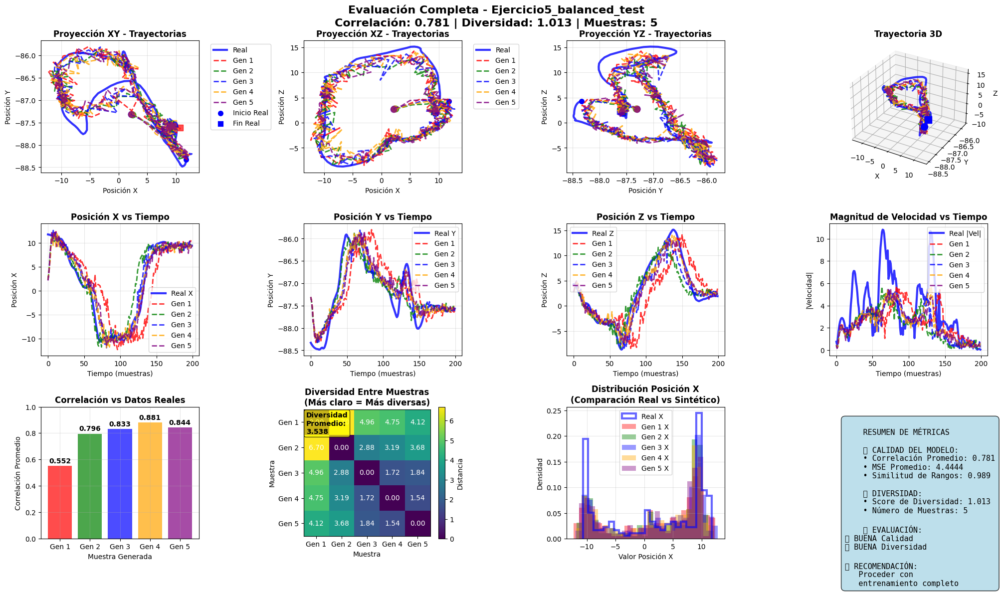

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.781       | 1.013      | 0.897
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.781 > 0.70
   ✅ Diversidad: 1.013 > 0.55
   ✅ Score balance: 0.897
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.781, Div=1.013

🚀 Procesando: activos2_izquierda_Ejercicio1
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1015 puntos
   • Después de limpieza: 1015 puntos
   📐 Rangos de posición: [32.813  2.184 21.517]
   🏃 Rangos de velocidad: [24.976 12.419 19.568]
   📊 Variabilidad espacial: 18.838
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

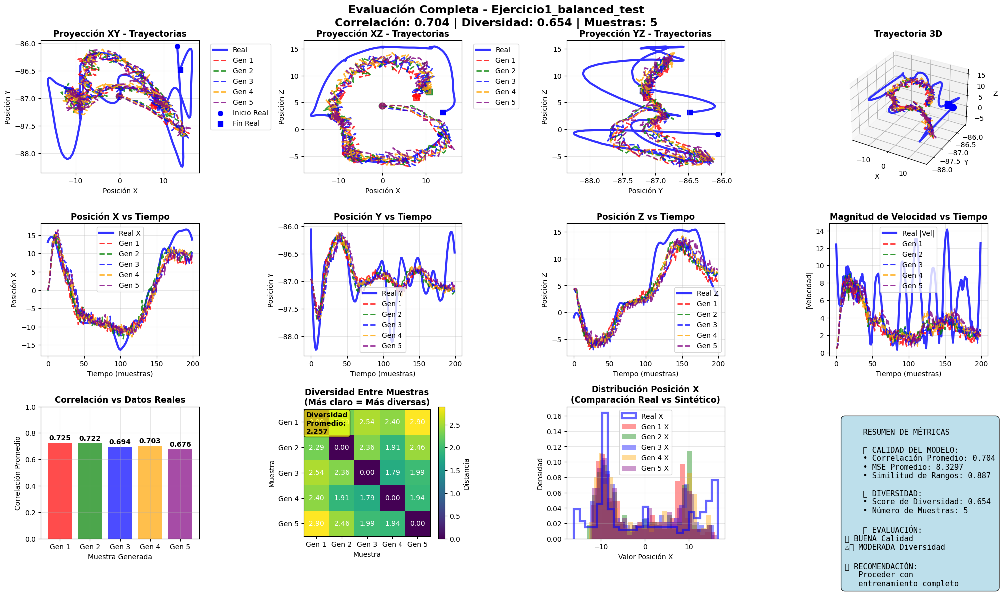

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.704       | 0.654      | 0.679
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.704 > 0.70
   ✅ Diversidad: 0.654 > 0.55
   ✅ Score balance: 0.679
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.704, Div=0.654

🚀 Procesando: activos2_izquierda_Ejercicio2
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio2
📊 Cargando Ejercicio2…
   • Datos originales: 1053 puntos
   • Después de limpieza: 1053 puntos
   📐 Rangos de posición: [24.376  2.55  19.711]
   🏃 Rangos de velocidad: [16.488  9.098 21.989]
   📊 Variabilidad espacial: 15.546
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

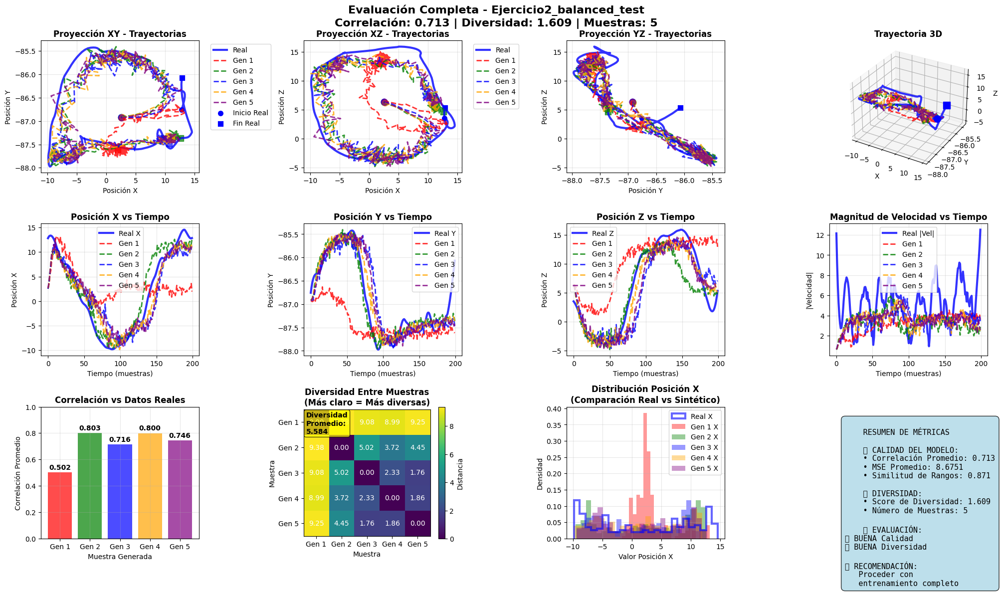

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.713       | 1.609      | 1.161
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.713 > 0.70
   ✅ Diversidad: 1.609 > 0.55
   ✅ Score balance: 1.161
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.713, Div=1.609

🚀 Procesando: activos2_izquierda_Ejercicio3
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio3
📊 Cargando Ejercicio3…
   • Datos originales: 1126 puntos
   • Después de limpieza: 1126 puntos
   📐 Rangos de posición: [22.974  2.077 18.422]
   🏃 Rangos de velocidad: [16.891  6.48  15.353]
   📊 Variabilidad espacial: 14.491
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

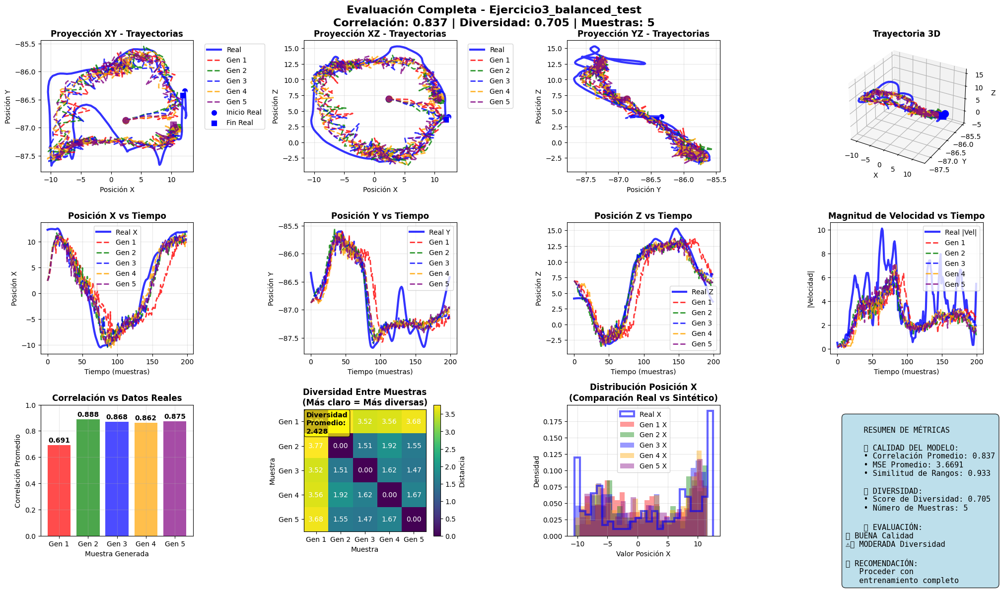

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.837       | 0.705      | 0.771
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.837 > 0.70
   ✅ Diversidad: 0.705 > 0.55
   ✅ Score balance: 0.771
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.837, Div=0.705

🚀 Procesando: activos2_izquierda_Ejercicio4
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio4
📊 Cargando Ejercicio4…
   • Datos originales: 1029 puntos
   • Después de limpieza: 1029 puntos
   📐 Rangos de posición: [23.569  3.248 21.832]
   🏃 Rangos de velocidad: [17.004 10.267 30.368]
   📊 Variabilidad espacial: 16.216
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

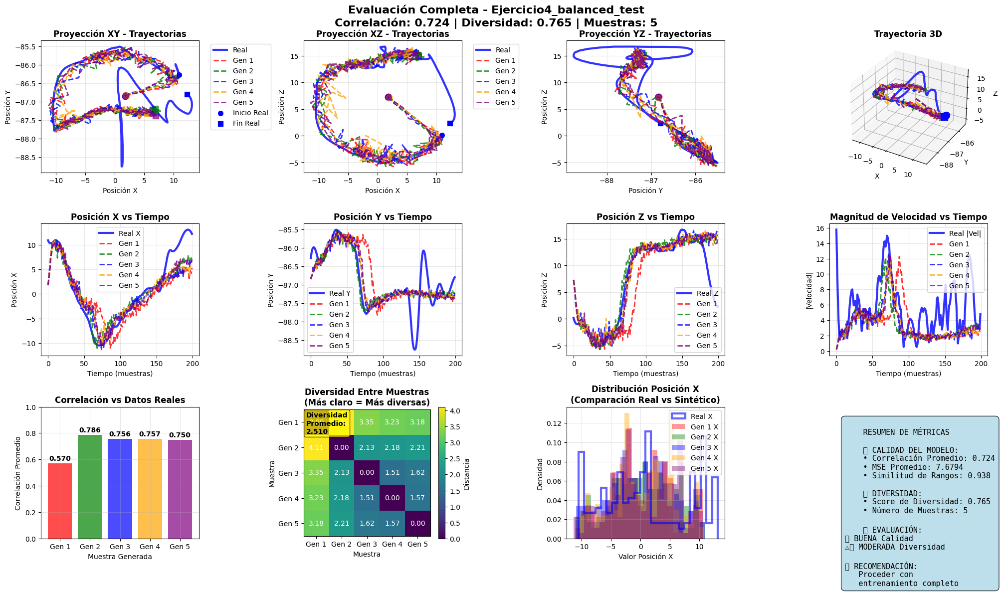

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.724       | 0.765      | 0.744
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   🎉 ¡ÉXITO COMPLETO! Balance óptimo alcanzado
   ✅ Correlación: 0.724 > 0.70
   ✅ Diversidad: 0.765 > 0.55
   ✅ Score balance: 0.744
   🚀 PERFECTO PARA TESIS
   ✅ ÉXITO: Corr=0.724, Div=0.765

🚀 Procesando: activos2_izquierda_Ejercicio5
🧪 PRUEBA CON CONFIGURACIÓN BALANCEADA
🎯 Objetivo: Correlación 0.60+ Y Diversidad 0.60+

🏃 PROCESANDO Ejercicio5
📊 Cargando Ejercicio5…
   • Datos originales: 1380 puntos
   • Después de limpieza: 1380 puntos
   📐 Rangos de posición: [24.499  3.004 21.112]
   🏃 Rangos de velocidad: [15.108  4.469 19.755]
   📊 Variabilidad espacial: 16.205
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

🏋️ ENTRENAMIENTO BALANCEADO...
📚 Pre-entrenamiento balanceado...
   E

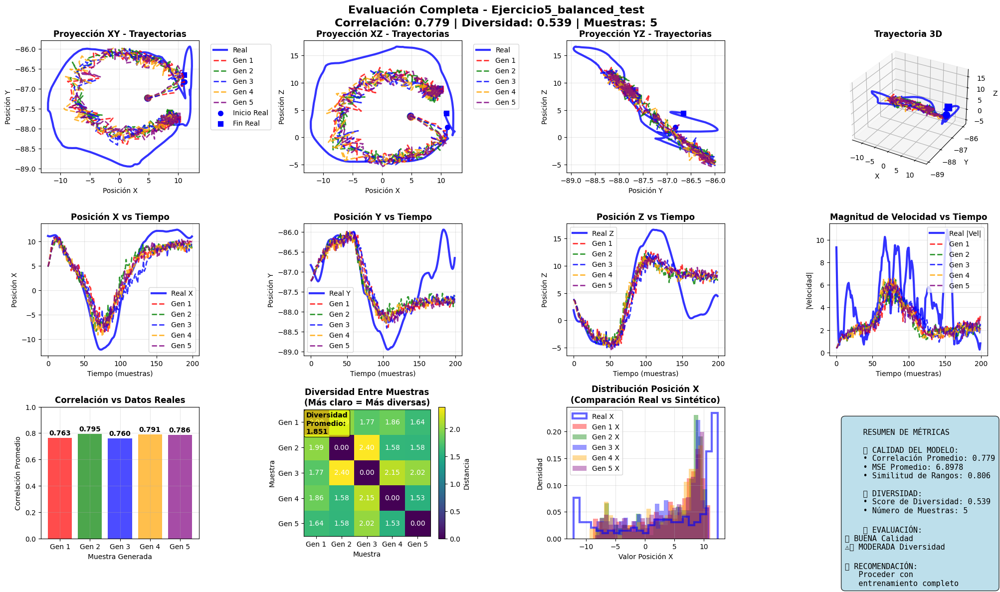

CONFIGURACIÓN    | CORRELACIÓN | DIVERSIDAD | BALANCE
------------------------------------------------------------
Balanceada       | 0.779       | 0.539      | 0.659
------------------------------------------------------------

🎯 EVALUACIÓN DEL BALANCE:
   ✅ BUEN balance alcanzado
   ✅ Correlación: 0.779
   ⚠️ Diversidad: 0.539
   📊 Score balance: 0.659
   👍 ACEPTABLE PARA TESIS
   ✅ ÉXITO: Corr=0.779, Div=0.539


In [23]:

results = {}
model_counter = 1
for name, info in available_data.items():
    activo, mano = name.split("_")
    for ejercicio in info['exercises']:
        print(f"\n🚀 Procesando: {activo}_{mano}_{ejercicio}")
        try:
            result = test_balanced_config(config, rf"C:\TIC_JE\Activos\realData\{name}.csv", ejercicio)
            if result and result['correlation'] > 0.6:
                print(f"   ✅ ÉXITO: Corr={result['correlation']:.3f}, Div={result['diversity']:.3f}")

                results[f"{name}_{ejercicio}"] = {
                    'correlation': result['correlation'],
                    'diversity': result['diversity'],
                    'balance_score': result['balance_score'],
                    'trainer': result['trainer']
                }
            else:
                print(f"   ❌ FALLO: Calidad insuficiente")

            model_counter += 1
        except Exception as e:
            print(f"   ❌ ERROR: {e}")
            model_counter += 1
            continue         


🚀 Procesando: activos1_derecha_Ejercicio1

🚀 ENTRENANDO MODELO FINAL PARA activos1_derecha_Ejercicio1

🏃 PROCESANDO Ejercicio1
📊 Cargando Ejercicio1…
   • Datos originales: 1256 puntos
   • Después de limpieza: 1256 puntos
   📐 Rangos de posición: [26.663  4.069 36.577]
   🏃 Rangos de velocidad: [24.612  8.479 20.703]
   📊 Variabilidad espacial: 22.436
✅ Modelos creados - Total parámetros: 4,598,807
✅ Entrenador listo para datos de shape: (200, 6)

📚 Pre-entrenamiento Autoencoder (100 epochs)
   Epoch 0: AE Loss = 3.2438
   Epoch 30: AE Loss = 2.5168
   Epoch 60: AE Loss = 1.9864
   Epoch 90: AE Loss = 1.8677

📚 Pre-entrenamiento Supervisor (100 epochs)
   Epoch 0: S Loss = 2.0160
   Epoch 30: S Loss = 0.2629
   Epoch 60: S Loss = 0.1648
   Epoch 90: S Loss = 0.1431

⚔️ Entrenamiento Adversarial Final (250 epochs)
   Epoch 0: D=9.6644, G=4.6719
   Epoch 50: D=9.7545, G=1.8753
   Epoch 100: D=8.7754, G=1.8065
   Epoch 150: D=9.7634, G=0.4713
   Epoch 200: D=8.8386, G=0.7667
💾 Nuevo mej

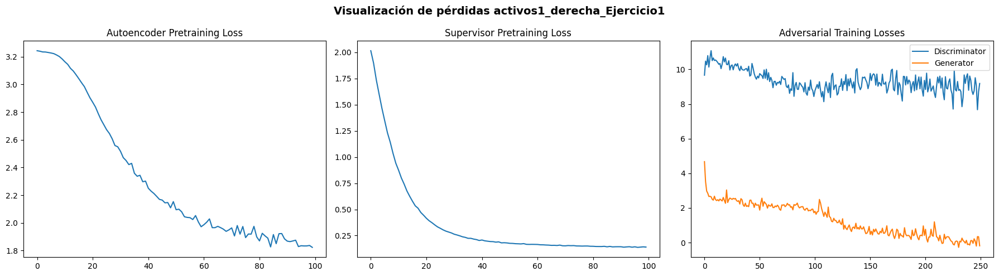

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio1.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.704
      🎭 Diversidad: 1.000
      🎯 Score final: 0.911
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.712
      🎭 Diversidad: 1.000
      🎯 Score final: 0.914
      🔄 Intentos: 2
      🛠️ Estrategia: frequency_modulation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.717
      🎭 Diversidad: 1.000
      🎯 Score final: 0.915
      🔄 Intentos: 36
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Pac

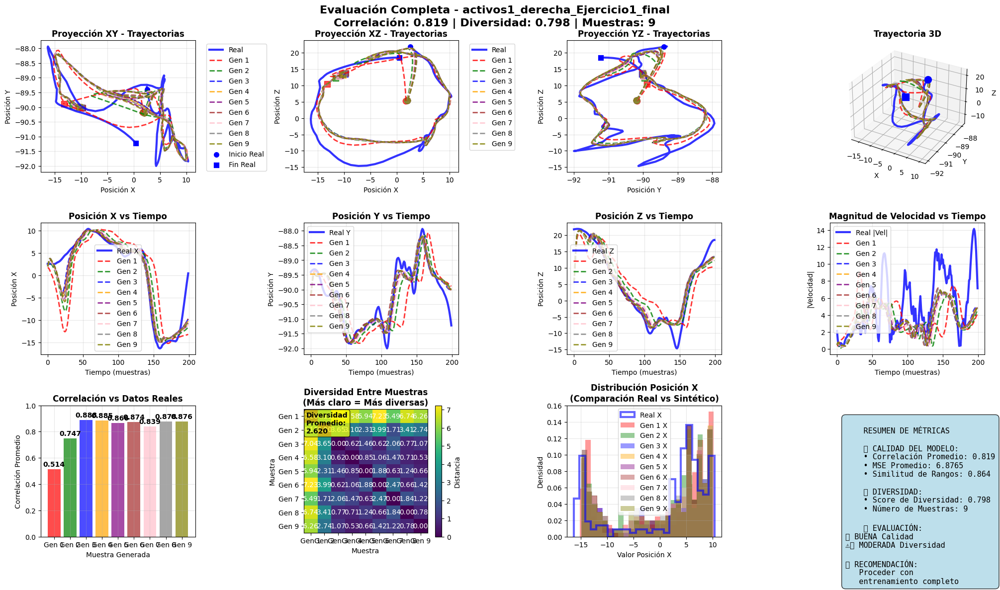

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio1.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente1_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente2_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente3_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente4_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente5_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente6_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio1\paciente7_activos1_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Acti

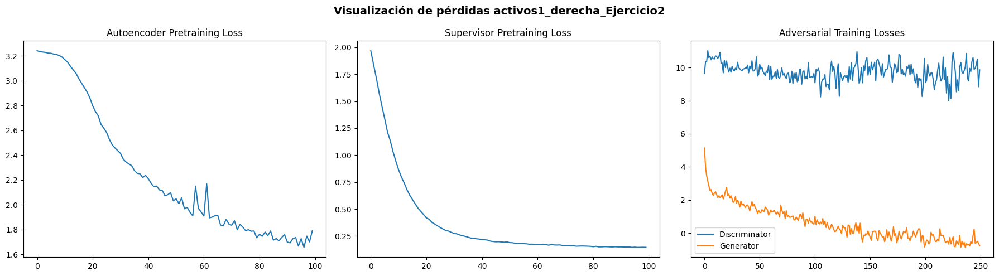

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio2.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.692
      🎭 Diversidad: 1.000
      🎯 Score final: 0.908
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.693
      🎭 Diversidad: 1.000
      🎯 Score final: 0.908
      🔄 Intentos: 8
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 15
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.692
      🎭 Diversidad: 1.000
      🎯 Score final: 0.908
      🔄 Intentos: 14
      🛠️ Estrategia: combo_modulation_shift

👤 Gener

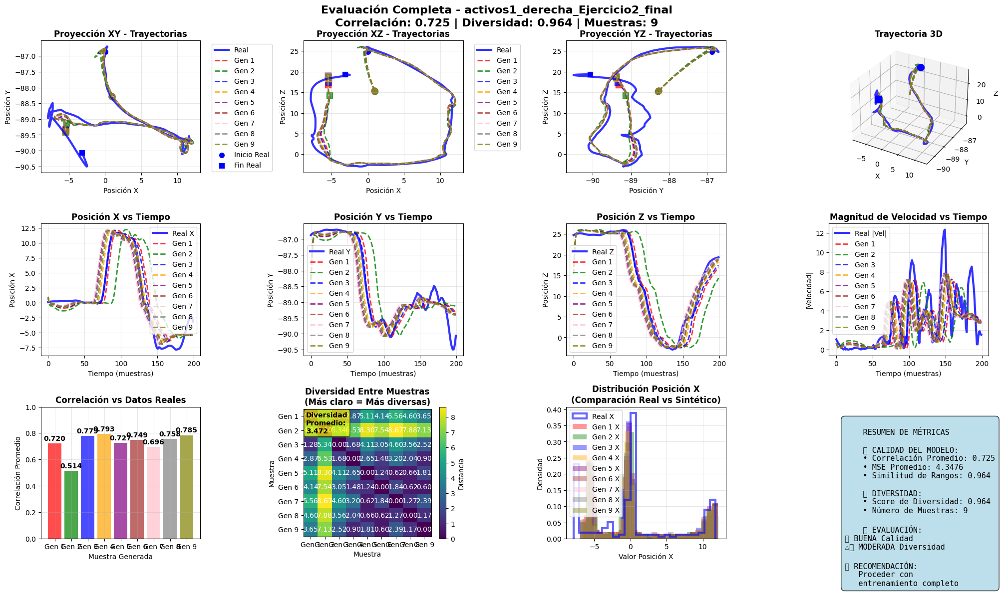

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio2.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente1_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente2_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente3_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente4_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente5_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente6_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio2\paciente7_activos1_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Acti

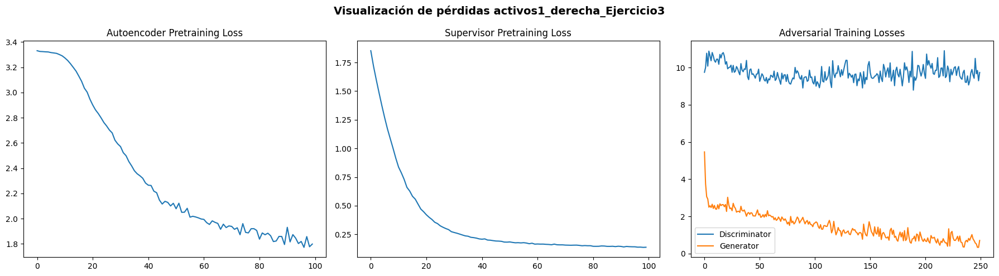

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio3.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.753
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.754
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 437
      🛠️ Estrategia: temporal_phase_shift

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.754
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 280
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Real

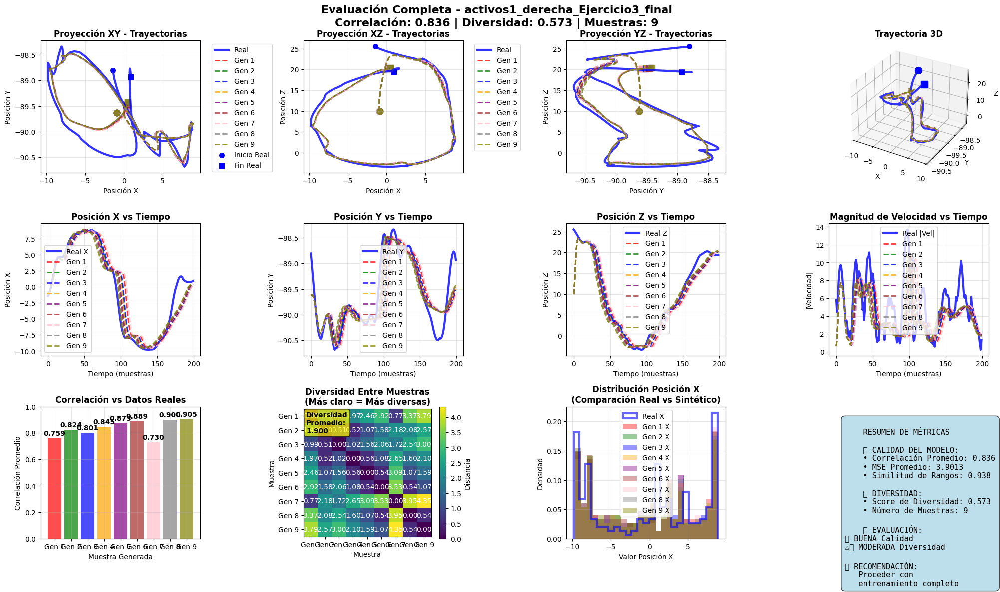

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio3.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente1_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente2_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente3_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente4_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente5_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente6_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio3\paciente7_activos1_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Acti

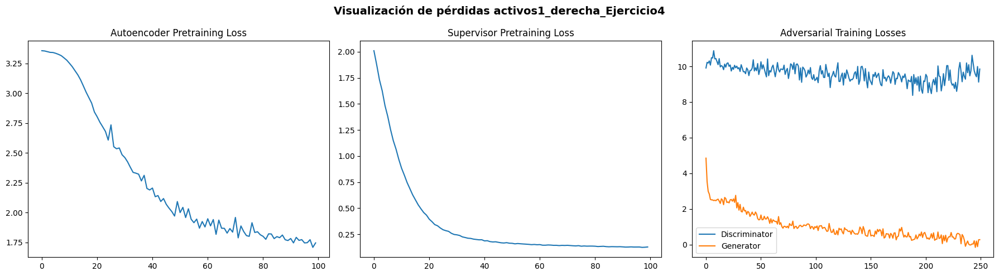

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio4.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.690
      🎭 Diversidad: 1.000
      🎯 Score final: 0.907
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.694
      🎭 Diversidad: 1.000
      🎯 Score final: 0.908
      🔄 Intentos: 337
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.693
      🎭 Diversidad: 1.000
      🎯 Score final: 0.908
      🔄 Intentos: 274
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Realis

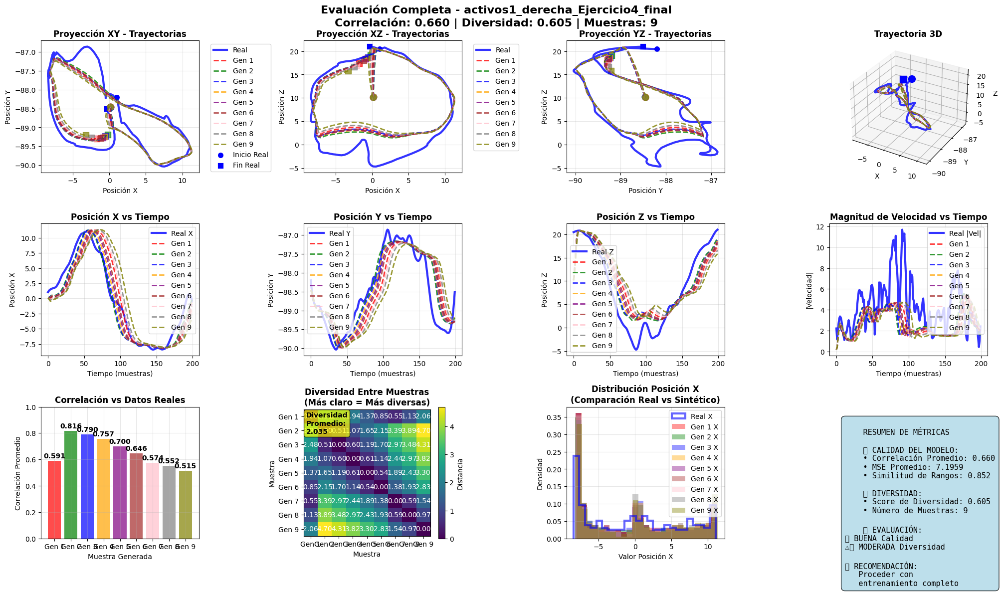

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio4.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente1_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente2_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente3_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente4_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente5_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente6_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio4\paciente7_activos1_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Acti

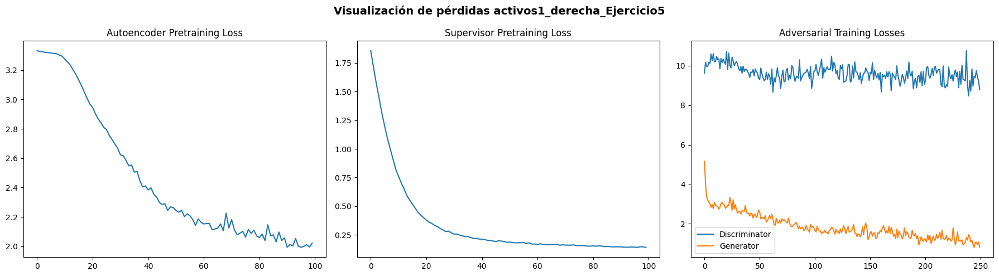

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_derecha_Ejercicio5.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.703
      🎭 Diversidad: 1.000
      🎯 Score final: 0.911
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 99
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.704
      🎭 Diversidad: 1.000
      🎯 Score final: 0.911
      🔄 Intentos: 77
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.705
      🎭 Diversidad: 1.000
      🎯 Score final: 0.911
      🔄 Intentos: 273
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 4/9...
   ✅ ÉXIT

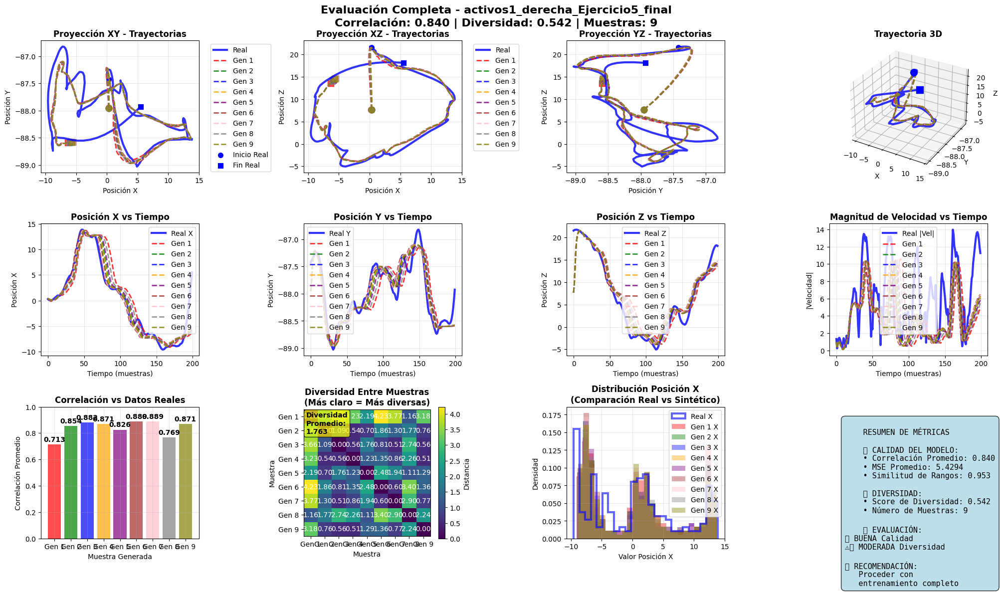

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_derecha_Ejercicio5.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente1_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente2_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente3_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente4_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente5_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente6_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\derecha\Ejercicio5\paciente7_activos1_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Acti

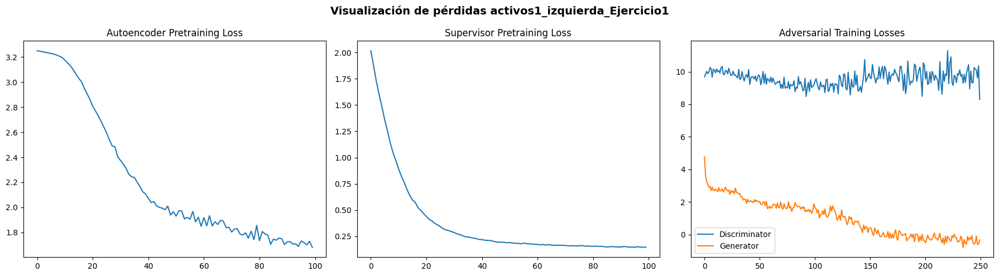

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_izquierda_Ejercicio1.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.742
      🎭 Diversidad: 1.000
      🎯 Score final: 0.923
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.745
      🎭 Diversidad: 1.000
      🎯 Score final: 0.924
      🔄 Intentos: 239
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.745
      🎭 Diversidad: 1.000
      🎯 Score final: 0.924
      🔄 Intentos: 141
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Real

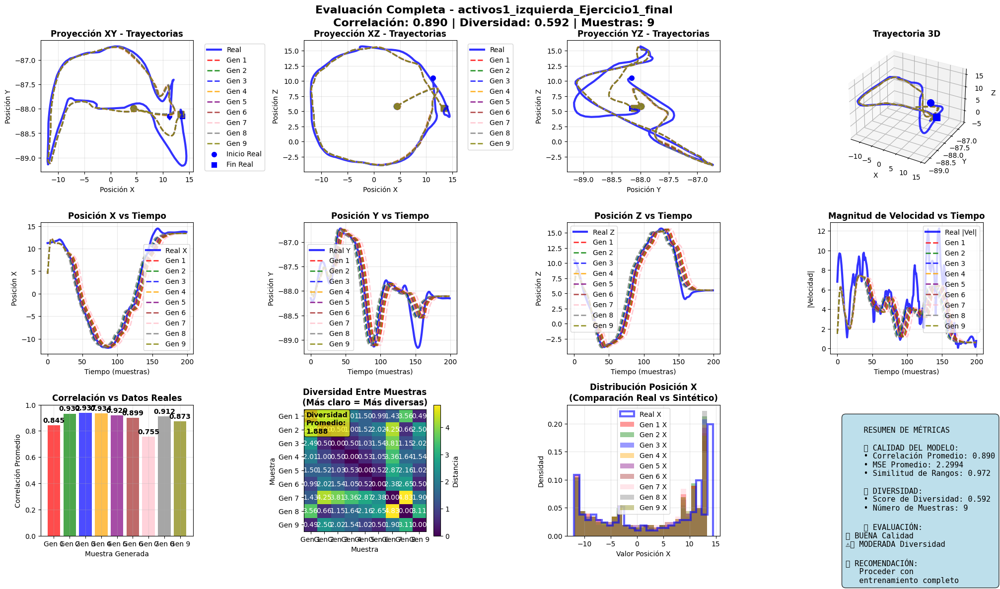

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_izquierda_Ejercicio1.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente1_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente2_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente3_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente4_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente5_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente6_activos1_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio1\paciente7_activos1_izquierda_Ejercicio1.

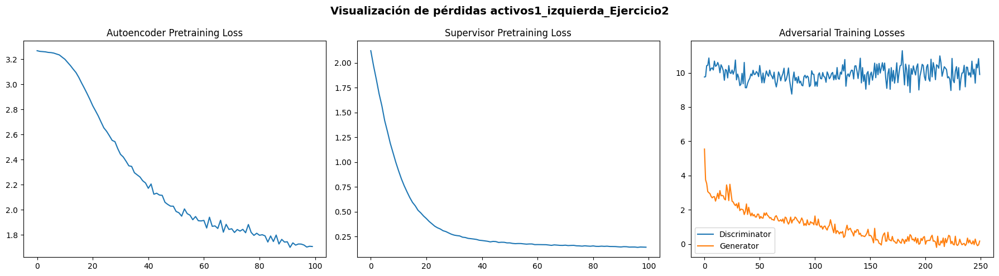

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_izquierda_Ejercicio2.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.712
      🎭 Diversidad: 1.000
      🎯 Score final: 0.914
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.712
      🎭 Diversidad: 1.000
      🎯 Score final: 0.914
      🔄 Intentos: 343
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.712
      🎭 Diversidad: 1.000
      🎯 Score final: 0.914
      🔄 Intentos: 419
      🛠️ Estrategia: hybrid_approach

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Realism

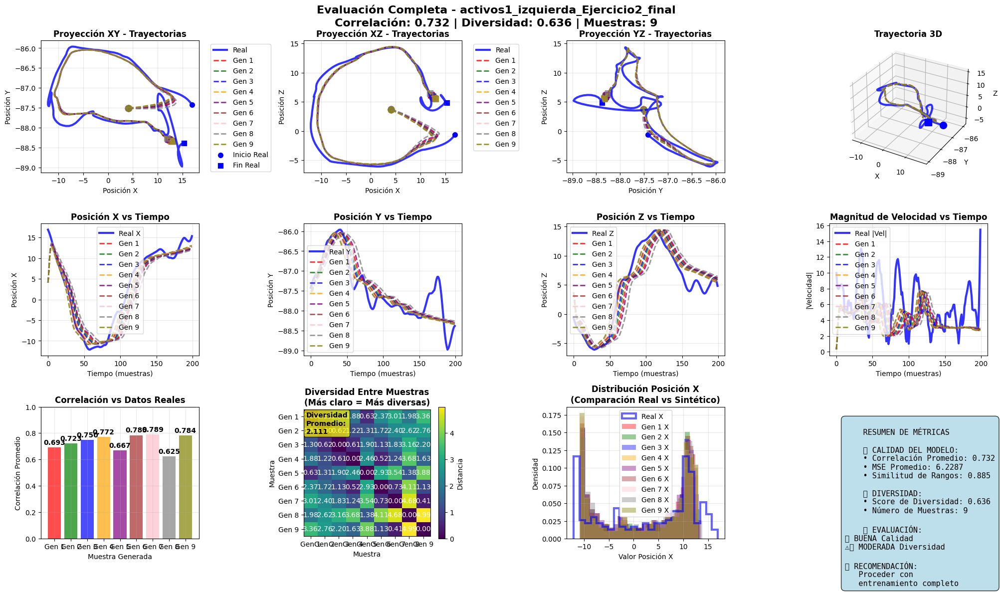

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_izquierda_Ejercicio2.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente1_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente2_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente3_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente4_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente5_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente6_activos1_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio2\paciente7_activos1_izquierda_Ejercicio2.

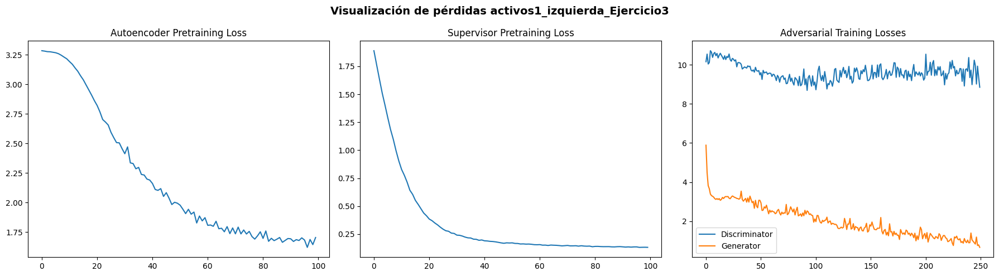

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_izquierda_Ejercicio3.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.744
      🎭 Diversidad: 1.000
      🎯 Score final: 0.923
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.748
      🎭 Diversidad: 1.000
      🎯 Score final: 0.924
      🔄 Intentos: 92
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.747
      🎭 Diversidad: 1.000
      🎯 Score final: 0.924
      🔄 Intentos: 414
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Reali

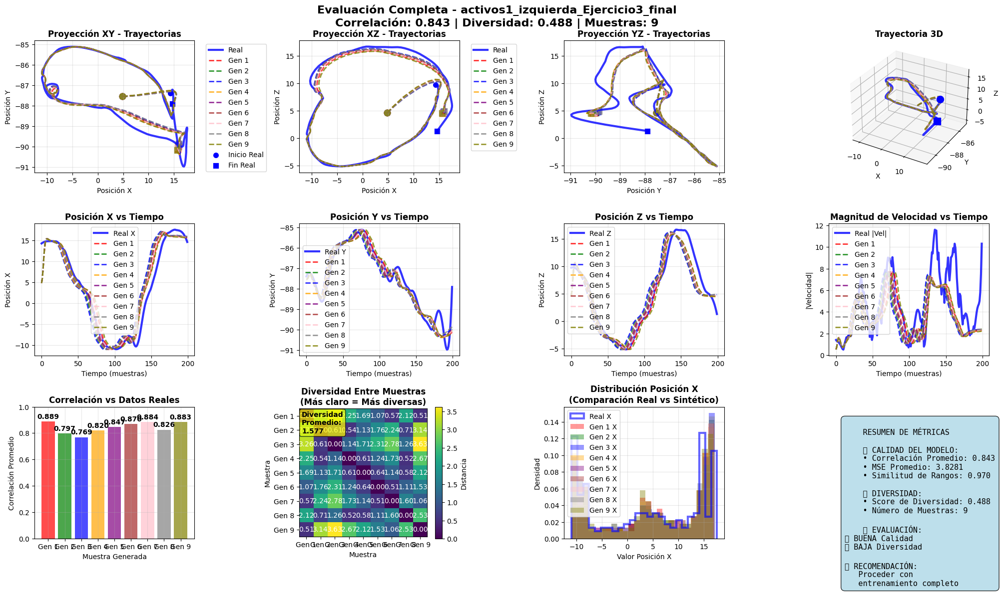

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_izquierda_Ejercicio3.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente1_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente2_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente3_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente4_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente5_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente6_activos1_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio3\paciente7_activos1_izquierda_Ejercicio3.

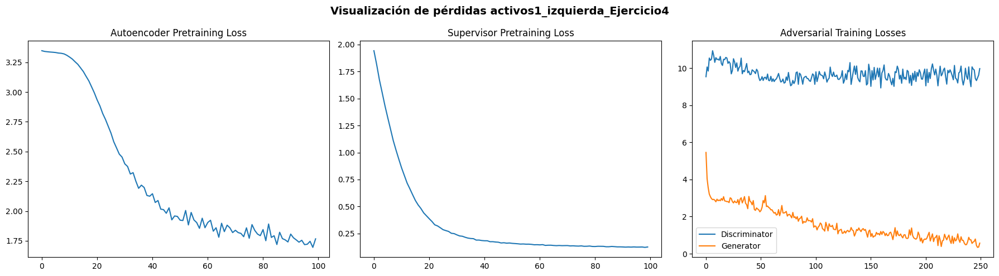

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_izquierda_Ejercicio4.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.751
      🎭 Diversidad: 1.000
      🎯 Score final: 0.925
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.759
      🎭 Diversidad: 1.000
      🎯 Score final: 0.928
      🔄 Intentos: 8
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 155
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.757
      🎭 Diversidad: 1.000
      🎯 Score final: 0.927
      🔄 Intentos: 18
      🛠️ Estrategia: amplitude_scaling

👤 Generan

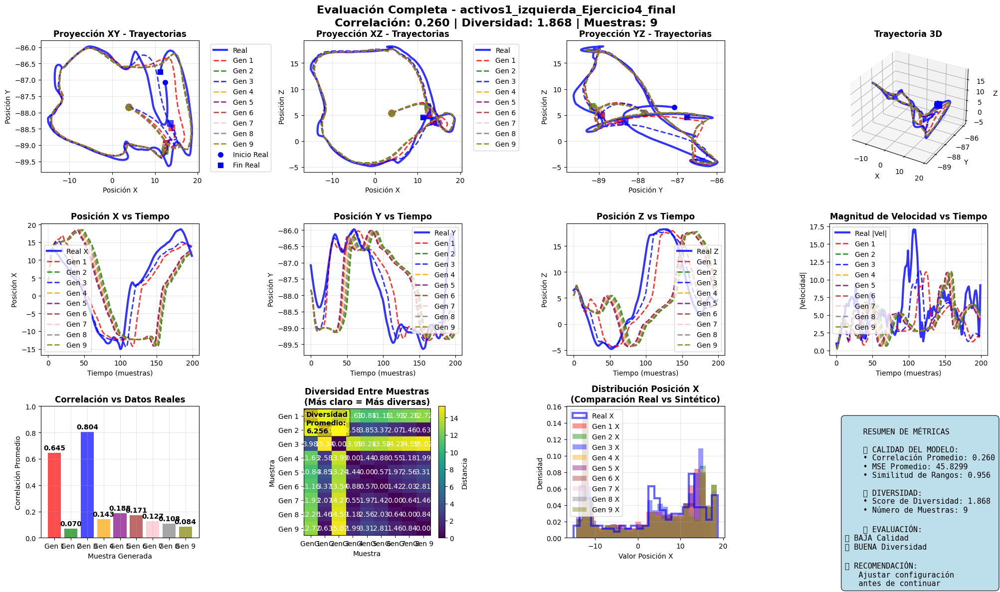

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_izquierda_Ejercicio4.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente1_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente2_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente3_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente4_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente5_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente6_activos1_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio4\paciente7_activos1_izquierda_Ejercicio4.

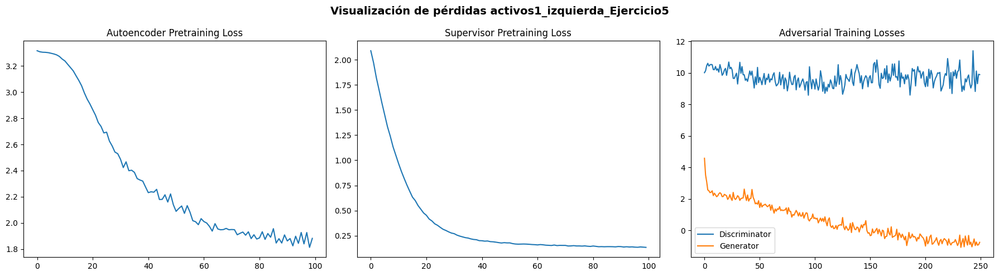

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos1_izquierda_Ejercicio5.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.729
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.741
      🎭 Diversidad: 1.000
      🎯 Score final: 0.922
      🔄 Intentos: 351
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.741
      🎭 Diversidad: 1.000
      🎯 Score final: 0.922
      🔄 Intentos: 15
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Reali

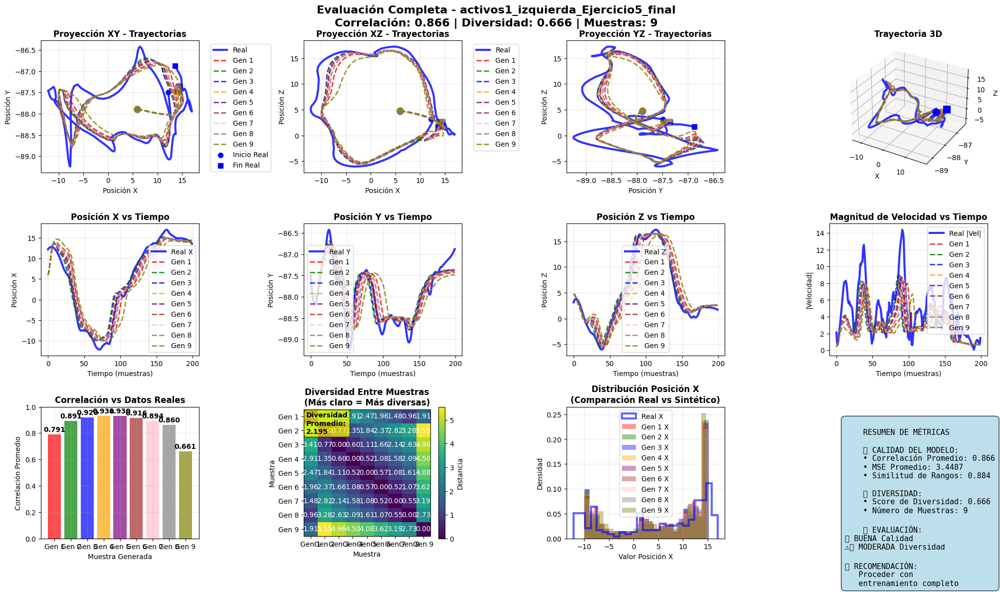

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos1_izquierda_Ejercicio5.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente1_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente2_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente3_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente4_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente5_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente6_activos1_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos1\izquierda\Ejercicio5\paciente7_activos1_izquierda_Ejercicio5.

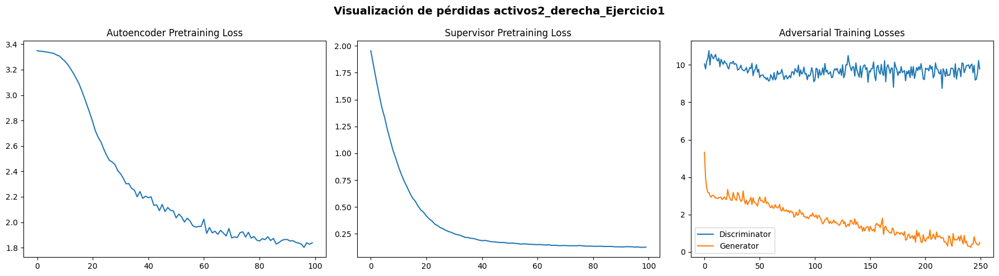

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_derecha_Ejercicio1.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.714
      🎭 Diversidad: 1.000
      🎯 Score final: 0.914
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.716
      🎭 Diversidad: 1.000
      🎯 Score final: 0.915
      🔄 Intentos: 2
      🛠️ Estrategia: frequency_modulation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 71
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.717
      🎭 Diversidad: 1.000
      🎯 Score final: 0.915
      🔄 Intentos: 36
      🛠️ Estrategia: high_noise_variation

👤 Generan

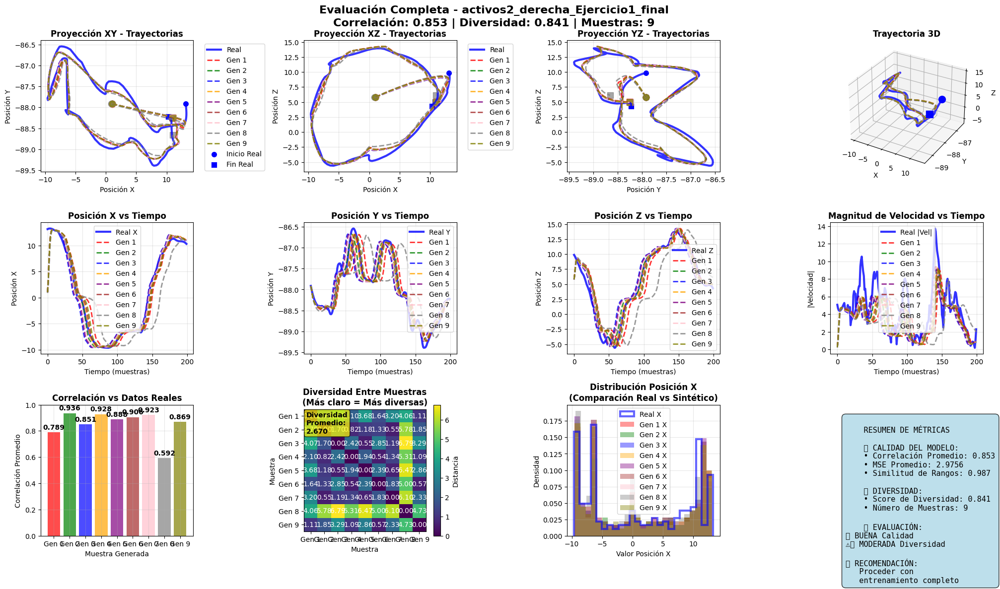

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_derecha_Ejercicio1.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente1_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente2_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente3_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente4_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente5_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente6_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio1\paciente7_activos2_derecha_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Acti

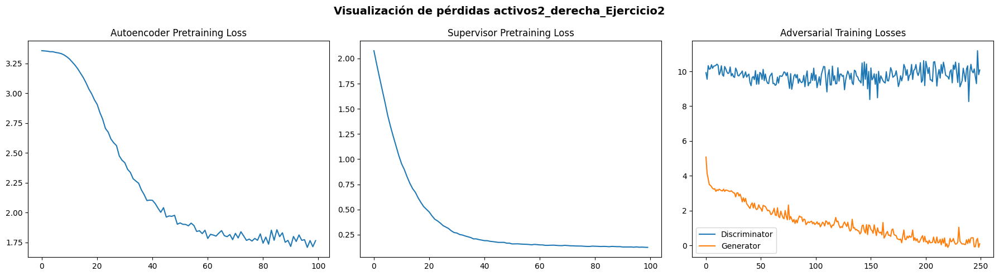

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_derecha_Ejercicio2.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.729
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.729
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 504
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.729
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 350
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Re

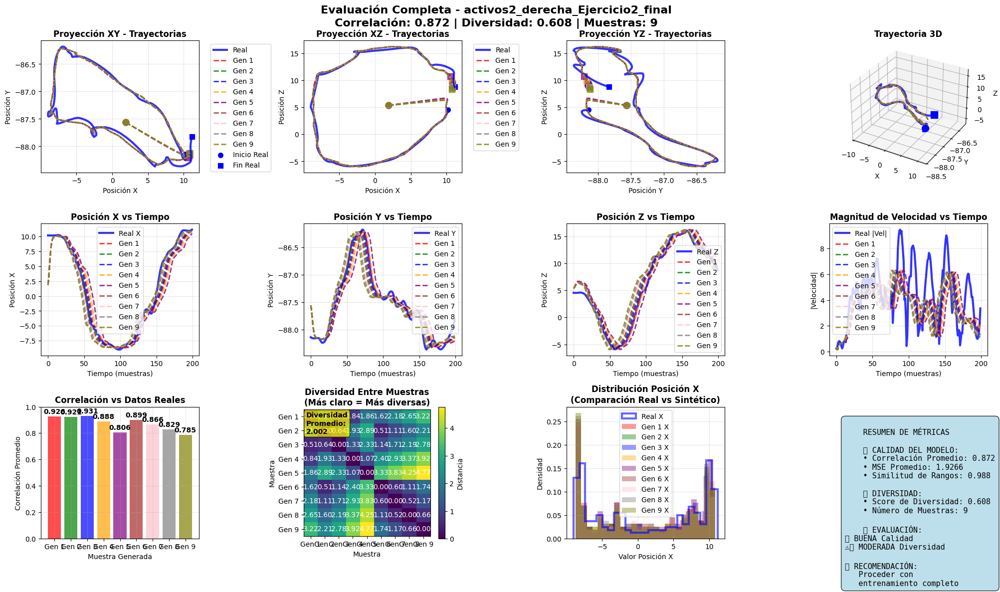

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_derecha_Ejercicio2.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente1_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente2_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente3_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente4_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente5_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente6_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio2\paciente7_activos2_derecha_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Acti

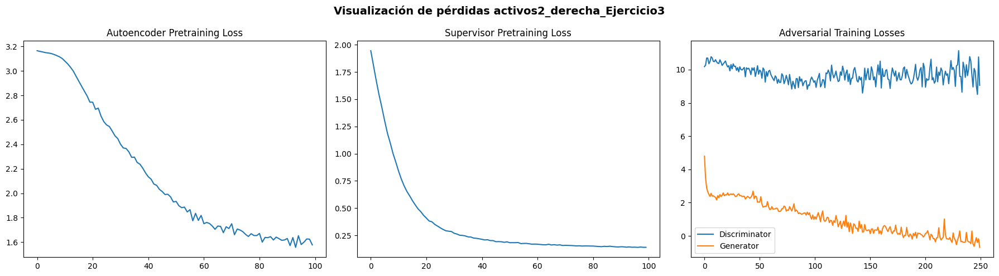

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_derecha_Ejercicio3.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.763
      🎭 Diversidad: 1.000
      🎯 Score final: 0.929
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.769
      🎭 Diversidad: 1.000
      🎯 Score final: 0.931
      🔄 Intentos: 8
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 15
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.763
      🎭 Diversidad: 1.000
      🎯 Score final: 0.929
      🔄 Intentos: 7
      🛠️ Estrategia: combo_modulation_shift

👤 Genera

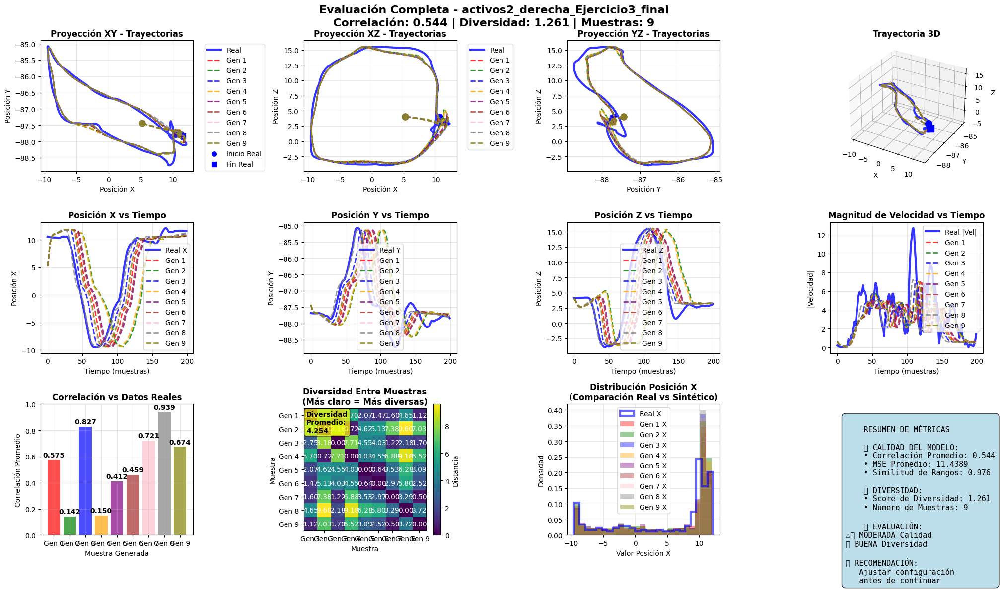

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_derecha_Ejercicio3.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente1_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente2_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente3_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente4_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente5_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente6_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio3\paciente7_activos2_derecha_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Acti

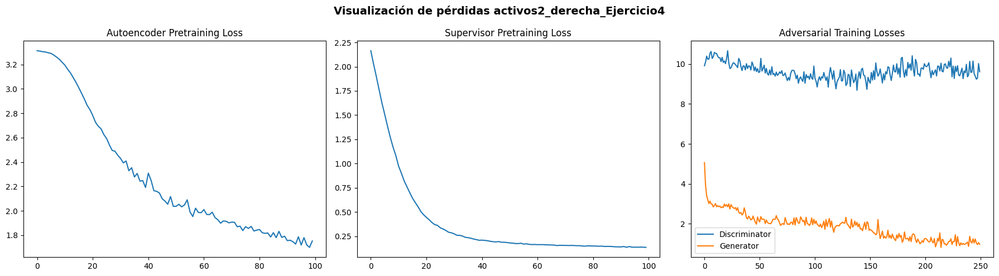

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_derecha_Ejercicio4.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.772
      🎭 Diversidad: 1.000
      🎯 Score final: 0.932
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.773
      🎭 Diversidad: 1.000
      🎯 Score final: 0.932
      🔄 Intentos: 183
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.772
      🎭 Diversidad: 1.000
      🎯 Score final: 0.932
      🔄 Intentos: 365
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Realis

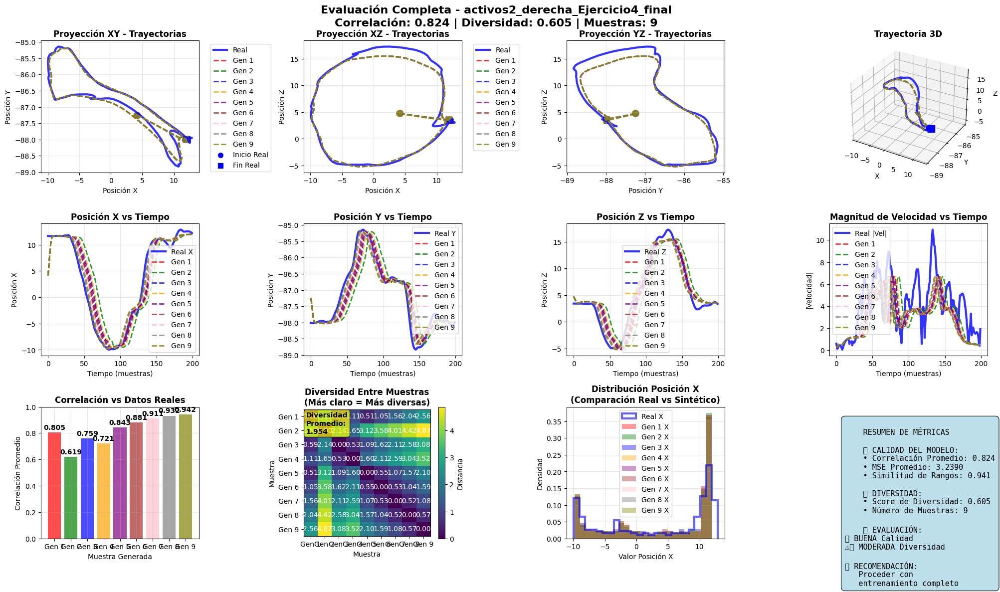

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_derecha_Ejercicio4.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente1_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente2_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente3_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente4_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente5_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente6_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio4\paciente7_activos2_derecha_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Acti

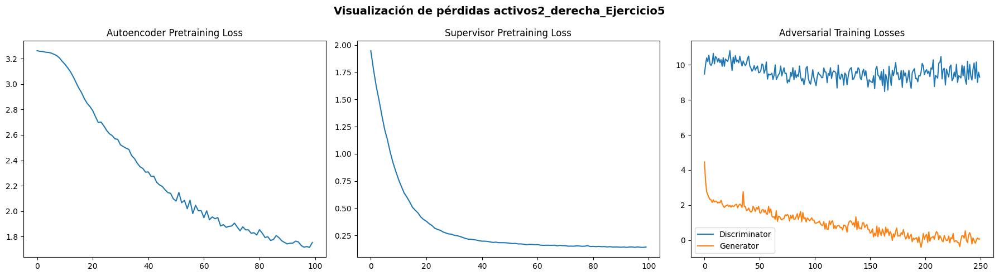

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_derecha_Ejercicio5.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.707
      🎭 Diversidad: 1.000
      🎯 Score final: 0.912
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 78
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.710
      🎭 Diversidad: 1.000
      🎯 Score final: 0.913
      🔄 Intentos: 20
      🛠️ Estrategia: hybrid_approach

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.710
      🎭 Diversidad: 1.000
      🎯 Score final: 0.913
      🔄 Intentos: 288
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Pacie

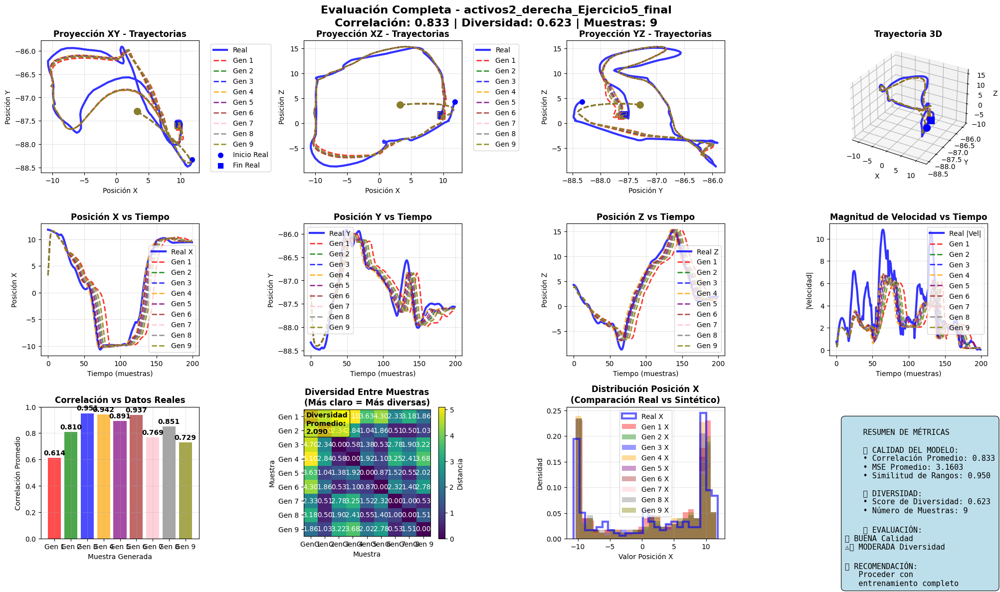

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_derecha_Ejercicio5.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente1_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente2_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente3_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente4_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente5_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente6_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\derecha\Ejercicio5\paciente7_activos2_derecha_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Acti

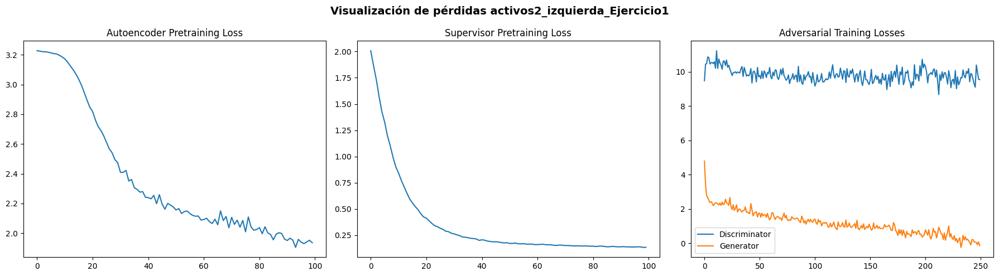

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_izquierda_Ejercicio1.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.719
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 8
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.721
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 3
      🛠️ Estrategia: temporal_phase_shift

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 71
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.722
      🎭 Diversidad: 1.000
      🎯 Score final: 0.916
      🔄 Intentos: 56
      🛠️ Estrategia: combo_modulation_shift

👤 Gen

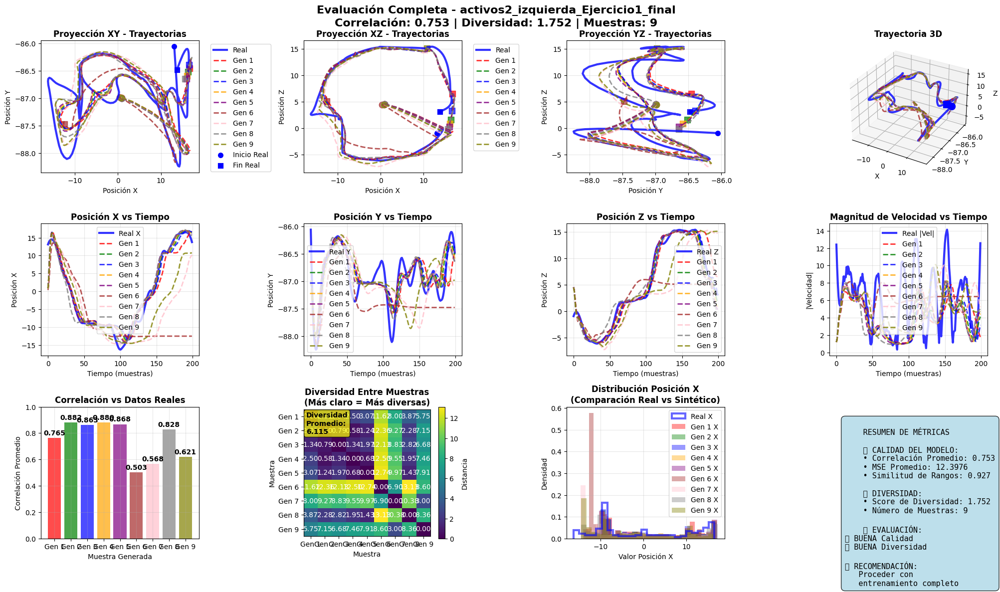

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_izquierda_Ejercicio1.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente1_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente2_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente3_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente4_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente5_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente6_activos2_izquierda_Ejercicio1.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio1\paciente7_activos2_izquierda_Ejercicio1.

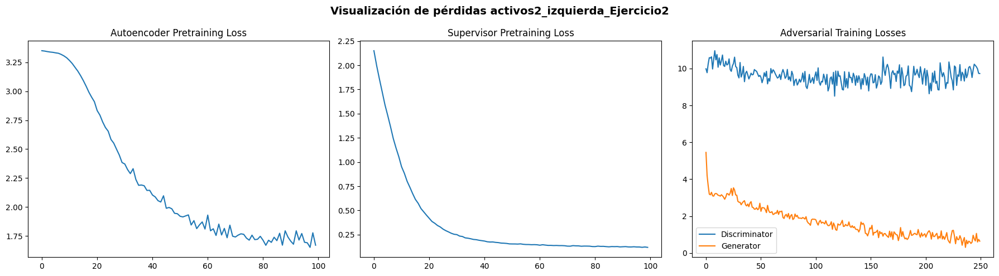

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_izquierda_Ejercicio2.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.740
      🎭 Diversidad: 1.000
      🎯 Score final: 0.922
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 470
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.742
      🎭 Diversidad: 1.000
      🎯 Score final: 0.922
      🔄 Intentos: 309
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 407
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.740
      🎭 Diversidad: 1.000
      🎯 Score final: 0.922
      🔄 Intentos: 204
      🛠️ Estrategia: high_noise_variation

👤

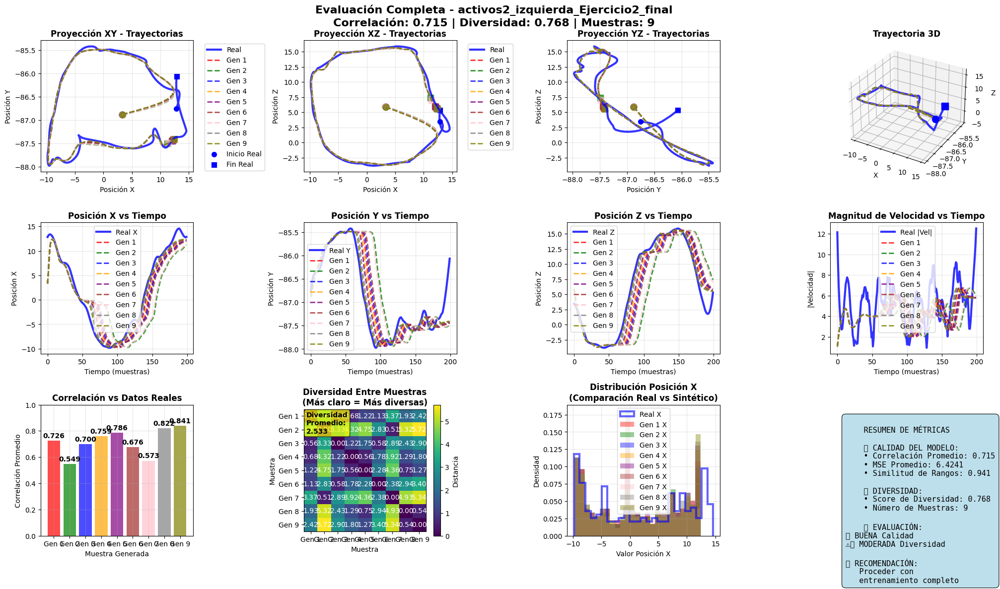

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_izquierda_Ejercicio2.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente1_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente2_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente3_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente4_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente5_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente6_activos2_izquierda_Ejercicio2.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio2\paciente7_activos2_izquierda_Ejercicio2.

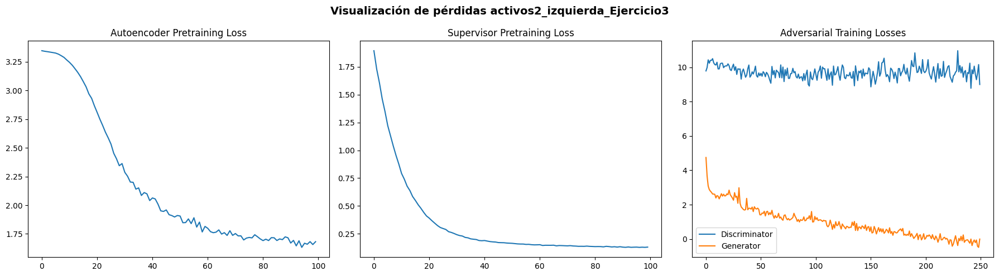

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_izquierda_Ejercicio3.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.754
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.755
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 134
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.754
      🎭 Diversidad: 1.000
      🎯 Score final: 0.926
      🔄 Intentos: 203
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 Re

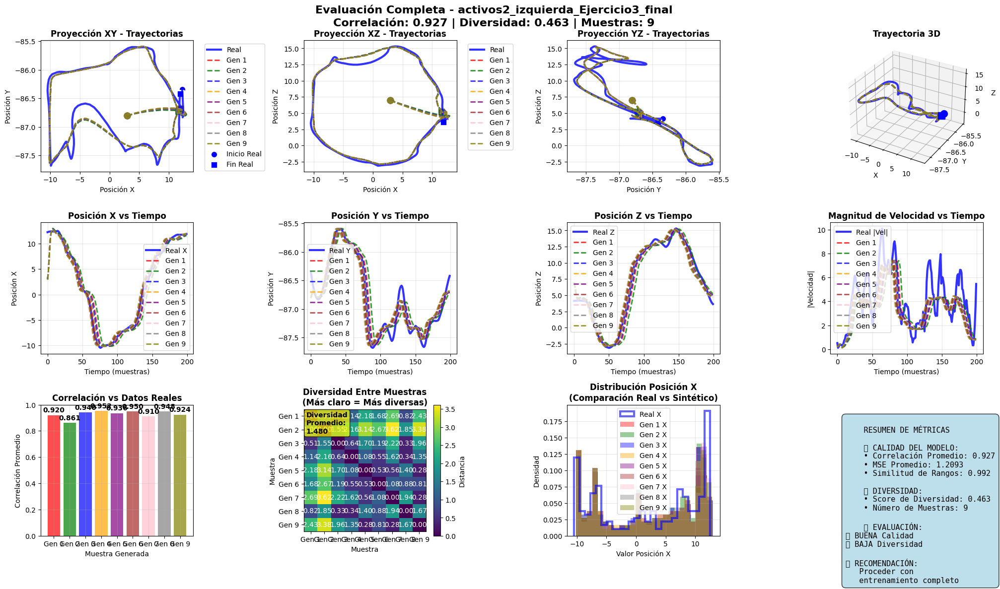

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_izquierda_Ejercicio3.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente1_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente2_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente3_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente4_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente5_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente6_activos2_izquierda_Ejercicio3.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio3\paciente7_activos2_izquierda_Ejercicio3.

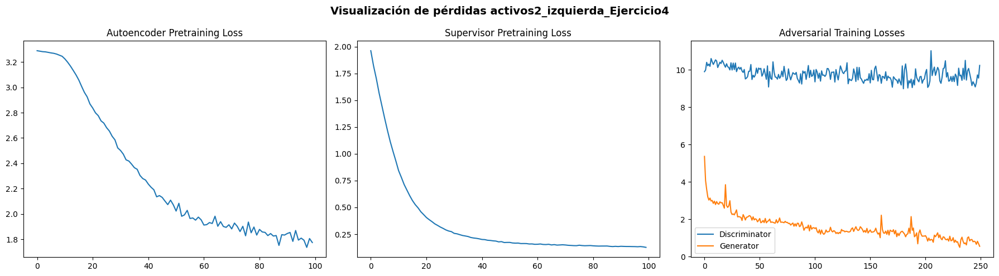

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_izquierda_Ejercicio4.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.727
      🎭 Diversidad: 1.000
      🎯 Score final: 0.918
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ⚡ Converged early at attempt 2
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.730
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 2
      🛠️ Estrategia: frequency_modulation

👤 Generando Paciente 3/9...
   ⚡ Converged early at attempt 71
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.731
      🎭 Diversidad: 1.000
      🎯 Score final: 0.919
      🔄 Intentos: 29
      🛠️ Estrategia: high_noise_variation

👤 Gener

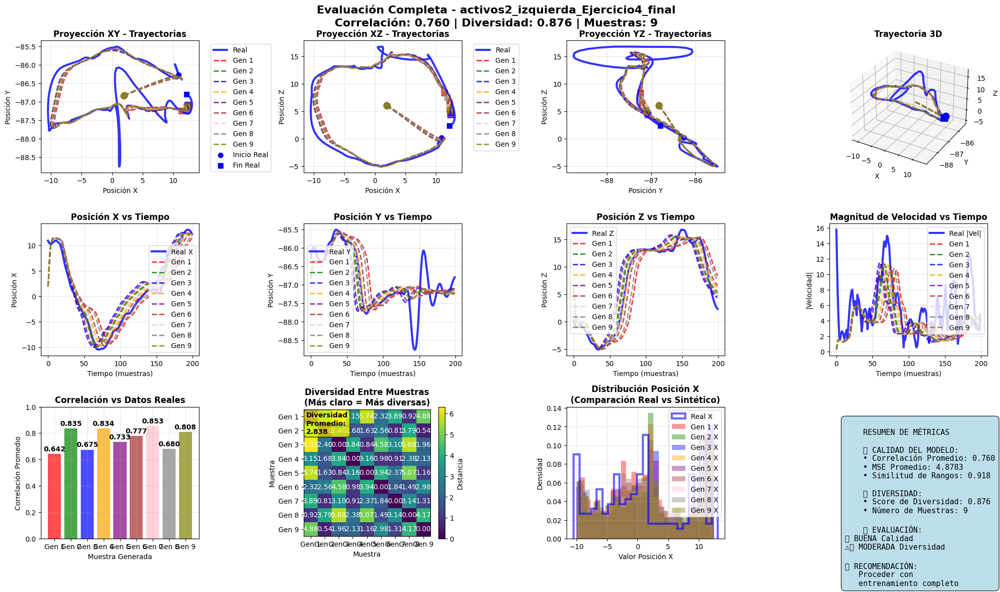

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_izquierda_Ejercicio4.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente1_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente2_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente3_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente4_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente5_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente6_activos2_izquierda_Ejercicio4.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio4\paciente7_activos2_izquierda_Ejercicio4.

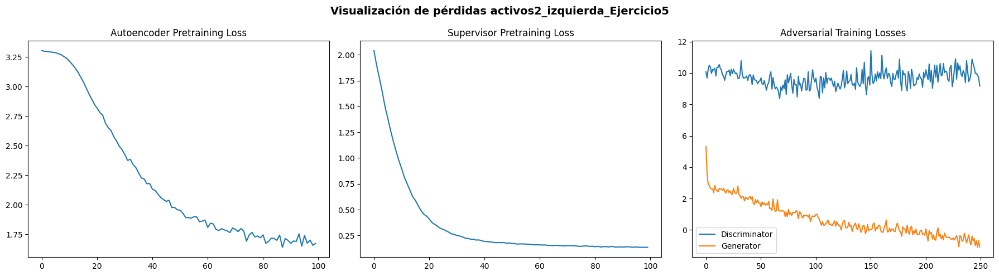

📉 Imagen de pérdidas guardada en: C:\TIC_JE\Activos\timeGan\images\losses_activos2_izquierda_Ejercicio5.png

🎭 GENERANDO 9 PACIENTES DIVERSOS
🎯 Configuración de diversidad:
   • Distancia mínima: 0.25
   • Similitud máxima: 0.75
   • Intentos máximos: 600
   • Umbral de calidad: 0.25

👤 Generando Paciente 1/9...
   ⚡ Converged early at attempt 1
   ✅ ÉXITO - Paciente 1 generado
      📊 Realismo: 0.766
      🎭 Diversidad: 1.000
      🎯 Score final: 0.930
      🔄 Intentos: 1
      🛠️ Estrategia: high_noise_variation

👤 Generando Paciente 2/9...
   ✅ ÉXITO - Paciente 2 generado
      📊 Realismo: 0.766
      🎭 Diversidad: 1.000
      🎯 Score final: 0.930
      🔄 Intentos: 469
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 3/9...
   ✅ ÉXITO - Paciente 3 generado
      📊 Realismo: 0.766
      🎭 Diversidad: 1.000
      🎯 Score final: 0.930
      🔄 Intentos: 56
      🛠️ Estrategia: combo_modulation_shift

👤 Generando Paciente 4/9...
   ✅ ÉXITO - Paciente 4 generado
      📊 R

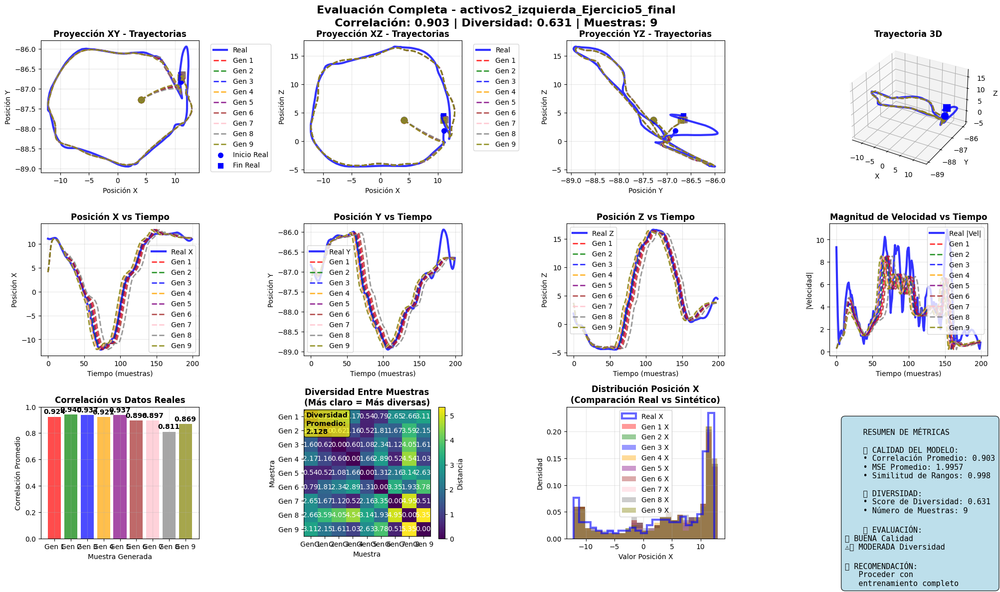

⚠️ Imagen no encontrada: C:\TIC_JE\Activos\timeGan\checkpoints\evaluation_activos2_izquierda_Ejercicio5.png
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente1_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente2_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente3_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente4_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente5_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente6_activos2_izquierda_Ejercicio5.csv
✅ Guardado: C:\TIC_JE\Activos\syntheticData\pExercise\activos2\izquierda\Ejercicio5\paciente7_activos2_izquierda_Ejercicio5.

In [24]:
# Entrenar y generar para cada ejercicio
metricas_globales = []
from trainer import save_exercise
for name, info in available_data.items():
    activo, mano = name.split("_")
    for ejercicio in info['exercises']:
        print(f"\n🚀 Procesando: {activo}_{mano}_{ejercicio}")
        try:
            trainer, preprocessor, data, data_normalized = train_model(
                config=config,
                filepath=info['filepath'],
                activo=activo,
                mano=mano,
                ejercicio=ejercicio
            )

            etiqueta = f"{activo}_{mano}_{ejercicio}"
            generator = DiverseDataGenerator(trainer, preprocessor, config)
            real_denorm = preprocessor.scaler.inverse_transform(data_normalized)
            patients, _ = generator.generate_diverse_patients(n_patients=9)
            metrics = generator.create_enhanced_quick_visualization(real_denorm, patients, etiqueta=etiqueta + "_final")
            save_exercise(activo, mano, ejercicio, generator, patients)
            metrics['ejercicio'] = etiqueta
            metricas_globales.append(metrics)

        except Exception as e:
            print(f"❌ Error en {activo}_{mano}_{ejercicio}: {e}")

df_metricas = pd.DataFrame(metricas_globales)
df_metricas.to_csv("resumen_metricas_globales.csv", index=False)
print("\n✅ Resumen global guardado en resumen_metricas_globales.csv")


## 7. Análisis y visualización

### 7.1 Resumen global de generación

In [25]:
print("📊 RESUMEN GLOBAL DE GENERACIÓN DE DATOS SINTÉTICOS")
print("="*80)
import pandas as pd

df = pd.read_csv("resumen_metricas_globales.csv")

# Métricas promedio por ejercicio
resumen = df.groupby("ejercicio")[["avg_correlation", "avg_diversity", "range_similarity"]].mean()
print("📊 Métricas promedio por ejercicio:")
print(resumen)

# Mejor modelo por score combinado
df["score_combinado"] = (df["avg_correlation"] + df["avg_diversity"]) / 2
mejor_modelo = df.loc[df["score_combinado"].idxmax()]
print("\n🏆 Mejor modelo:")
print(mejor_modelo[["ejercicio", "avg_correlation", "avg_diversity", "score_combinado"]])

📊 RESUMEN GLOBAL DE GENERACIÓN DE DATOS SINTÉTICOS
📊 Métricas promedio por ejercicio:
                               avg_correlation  avg_diversity  \
ejercicio                                                       
activos1_derecha_Ejercicio1           0.818572       0.798269   
activos1_derecha_Ejercicio2           0.724613       0.964152   
activos1_derecha_Ejercicio3           0.836212       0.572849   
activos1_derecha_Ejercicio4           0.660256       0.605494   
activos1_derecha_Ejercicio5           0.840499       0.541881   
activos1_izquierda_Ejercicio1         0.889621       0.591546   
activos1_izquierda_Ejercicio2         0.731877       0.635759   
activos1_izquierda_Ejercicio3         0.842626       0.488051   
activos1_izquierda_Ejercicio4         0.260175       1.867639   
activos1_izquierda_Ejercicio5         0.865991       0.665682   
activos2_derecha_Ejercicio1           0.853478       0.841039   
activos2_derecha_Ejercicio2           0.872270       0.608152   
acti

### 7.2 Visualización global de resultados

#### 7.2.1 Score promedio de de correlación y diversidad

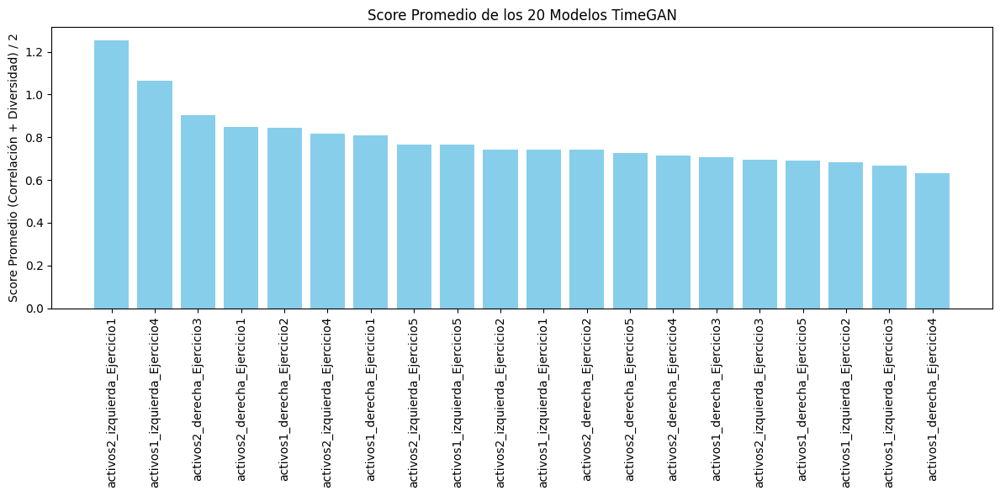

✅ Imagen guardada: barras_score_promedio_modelos.png


In [27]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Cargar métricas
df = pd.read_csv("resumen_metricas_globales.csv")

# Calcular score combinado
df["score_promedio"] = (df["avg_correlation"] + df["avg_diversity"]) / 2

# Extraer características y etiquetas
X = df[["avg_correlation", "avg_diversity", "range_similarity"]].values
labels = df["ejercicio"].values

# Diagrama de barras del score promedio
df_sorted = df.sort_values("score_promedio", ascending=False)
plt.figure(figsize=(12, 6))
plt.bar(df_sorted["ejercicio"], df_sorted["score_promedio"], color='skyblue')
plt.xticks(rotation=90)
plt.ylabel("Score Promedio (Correlación + Diversidad) / 2")
plt.title("Score Promedio de los 20 Modelos TimeGAN")
plt.tight_layout()
plt.savefig("barras_score_promedio_modelos.png", dpi=300)
plt.show()
print("✅ Imagen guardada: barras_score_promedio_modelos.png")


En el gráfico de barras inicial, vemos que:

- El mejor modelo fue `activos2_izquierda_Ejercicio1`, seguido por `activos1_izquierda_Ejercicio4` y `activos2_derecha_Ejercicio3`.

- En general, los modelos del lado izquierdo de activos2 tienden a estar entre los mejores.

- Modelos de activos1_derecha se concentran en la parte baja del ranking, especialmente Ejercicio4.

Esto sugiere que el modelo sintético tuvo mejor capacidad para capturar patrones en el lado izquierdo de activos2, posiblemente por mayor consistencia o menor ruido en los datos reales correspondientes.

#### 7.2.2 Resultados con normalización de métricas

In [28]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Copiar para normalizar (MSE se invierte porque menor es mejor)
df_norm = df.copy()
df_norm["modelo"] = df_norm["ejercicio"]
df_norm["avg_mse"] = df_norm["avg_mse"].max() - df_norm["avg_mse"]

# Normalización min-max
metricas = ["avg_correlation", "avg_mse", "avg_diversity", "range_similarity"]
scaler = MinMaxScaler()
df_norm[metricas] = scaler.fit_transform(df_norm[metricas])

# Indexar por nombre del modelo
df_norm.set_index("modelo", inplace=True)
df_norm.head()


,avg_correlation,avg_mse,avg_diversity,range_similarity,ejercicio,score_promedio
modelo,,,,,,
activos1_derecha_Ejercicio1,0.837480,0.872993,0.238751,0.080066,activos1_derecha_Ejercicio1,0.808421
activos1_derecha_Ejercicio2,0.696561,0.929667,0.356837,0.769924,activos1_derecha_Ejercicio2,0.844382
activos1_derecha_Ejercicio3,0.863936,0.939669,0.078282,0.589614,activos1_derecha_Ejercicio3,0.704531
activos1_derecha_Ejercicio4,0.600039,0.865834,0.101521,0.000000,activos1_derecha_Ejercicio4,0.632875
activos1_derecha_Ejercicio5,0.870366,0.905422,0.056236,0.690509,activos1_derecha_Ejercicio5,0.691190


In [35]:
# Guardar a CSV
df_norm.to_csv("metricas_normalizadas.csv", index=True)

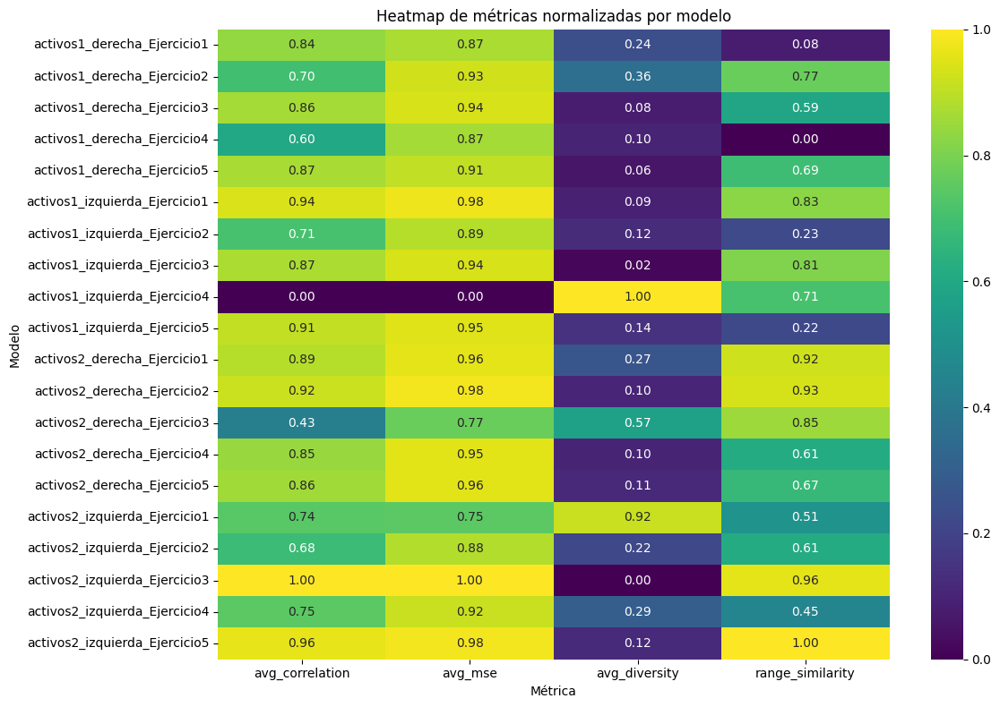

In [29]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.heatmap(df_norm[metricas], cmap="viridis", annot=True, fmt=".2f")
plt.title("Heatmap de métricas normalizadas por modelo")
plt.xlabel("Métrica")
plt.ylabel("Modelo")
plt.tight_layout()
plt.savefig("Heatmape_metricas_normalizadas.png", dpi=300)
plt.show()

El heatmap muestra un panorama detallado por modelo:

- `activos1_izquierda_Ejercicio4` tiene MSE muy alto (0.00 tras invertir y normalizar), pero diversidad perfecta (1.0), lo cual explica por qué aparece contradictoriamente alto en la métrica simple pero bajo en el score ponderado.

- Modelos con alta correlación y MSE bajo (normalizado), como `activos2_izquierda_Ejercicio3` y `activos2_izquierda_Ejercicio5`, son más consistentes.

- El patrón indica trade-offs claros: modelos con diversidad alta tienden a tener correlación baja, y viceversa.

Esto respalda el uso del score ponderado como medida más equilibrada.

In [36]:
# Definir pesos según criterio 
pesos = {
    "avg_correlation": 0.40,   # Más peso: reflejo directo de fidelidad
    "avg_mse": 0.30,           # Muy importante, mide error absoluto
    "range_similarity": 0.20, # Conservación del dominio
    "avg_diversity": 0.10      # Importante pero subordinado a fidelidad
}

# Calcular score ponderado
df_norm["score"] = sum(df_norm[m] * pesos[m] for m in metricas)

# Ordenar por score
ranking = df_norm.sort_values("score", ascending=False)
ranking[["score"] + metricas]

,score,avg_correlation,avg_mse,avg_diversity,range_similarity
modelo,,,,,
activos2_izquierda_Ejercicio5,0.892623,0.964814,0.982377,0.119841,1.000000
activos2_izquierda_Ejercicio3,0.891802,1.000000,1.000000,0.000000,0.959009
activos2_derecha_Ejercicio2,0.859635,0.918016,0.983924,0.103413,0.934548
activos2_derecha_Ejercicio1,0.855472,0.889832,0.960416,0.269197,0.922476
activos1_izquierda_Ejercicio1,0.844525,0.944039,0.975570,0.091592,0.825398
activos1_izquierda_Ejercicio3,0.795499,0.873555,0.941309,0.017917,0.809461
activos2_derecha_Ejercicio5,0.775349,0.858534,0.956276,0.113966,0.668282
activos1_derecha_Ejercicio5,0.763499,0.870366,0.905422,0.056236,0.690509
activos2_derecha_Ejercicio4,0.756444,0.845004,0.954511,0.101295,0.609798


El ranking más robusto muestra que los mejores modelos son:

| Modelo                          | Score  |
| ------------------------------- | ------ |
| `activos2_izquierda_Ejercicio5` | 0.8926 |
| `activos2_izquierda_Ejercicio3` | 0.8918 |
| `activos2_derecha_Ejercicio2`   | 0.8596 |
| `activos2_derecha_Ejercicio1`   | 0.8555 |
| `activos1_izquierda_Ejercicio1` | 0.8445 |

Todos son de activos2, tanto izquierda como derecha.

Los modelos peor evaluados tienen baja correlación o MSE alto, confirmando que estas métricas dominan en el score ponderado.

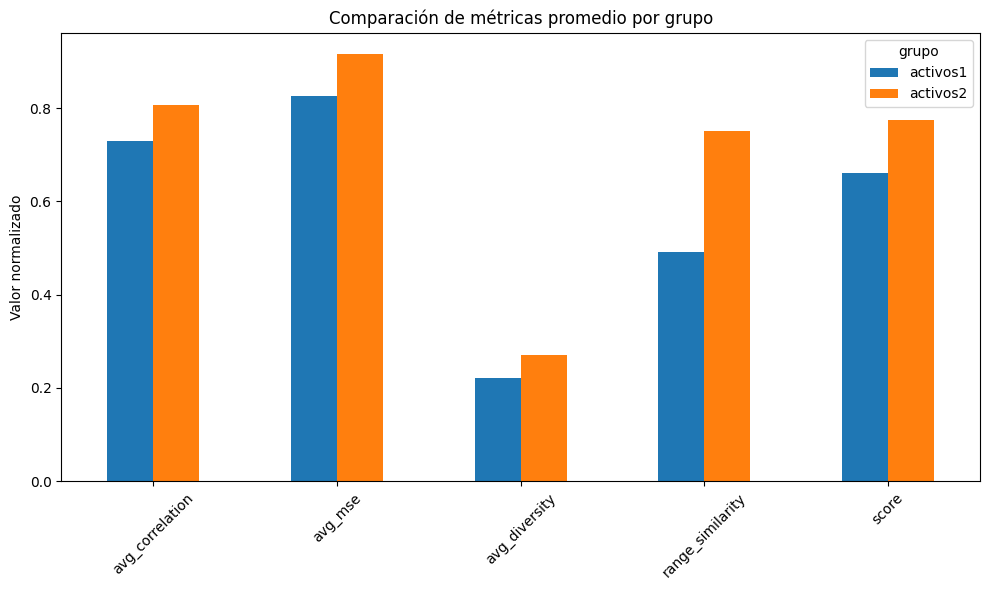

In [37]:
import re

# Extraer grupo (activos1 / activos2) del nombre
df_norm["grupo"] = df_norm.index.to_series().apply(lambda x: re.search(r"(activos[12])", x).group(1))

# Agrupar y promediar
promedios_grupo = df_norm.groupby("grupo")[metricas + ["score"]].mean()

# Visualizar
promedios_grupo.T.plot(kind="bar", figsize=(10, 6))
plt.title("Comparación de métricas promedio por grupo")
plt.ylabel("Valor normalizado")
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig("Comparacion_metricas_activos.png", dpi=300)
plt.show()

Del gráfico:

- `activos2` supera a `activos1` en todas las métricas promedio.

Las diferencias más grandes aparecen en range_similarity y score.

📌 Interpretación:

- `activos2` tiene mejor comportamiento biomecánico repetible.

- El modelo TimeGAN fue más eficaz con sus patrones.

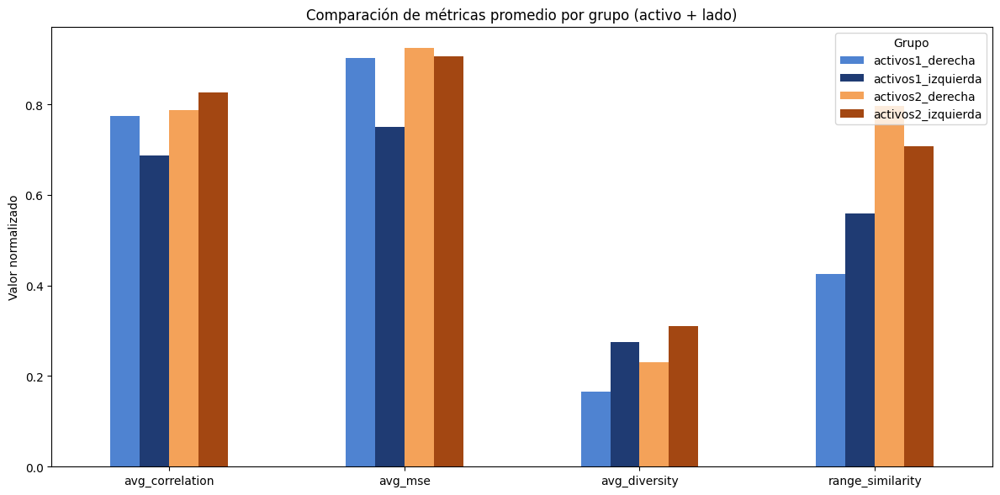

In [38]:
import re
import matplotlib.pyplot as plt

# Extraer grupo detallado (ej. activos1_derecha, activos2_izquierda)
df_norm["grupo_detallado"] = df_norm.index.to_series().apply(
    lambda x: re.search(r"(activos[12]_(?:derecha|izquierda))", x).group(1)
)

# Calcular promedios por grupo
promedios_detallado = df_norm.groupby("grupo_detallado")[metricas].mean()

# Colores personalizados
colores = {
    "activos1_izquierda": "#1f3b73",  # azul oscuro
    "activos1_derecha":   "#4f83d1",  # azul claro
    "activos2_izquierda": "#a34712",  # naranja oscuro
    "activos2_derecha":   "#f4a259"   # naranja claro
}

# Gráfico
ax = promedios_detallado.T.plot(
    kind="bar",
    figsize=(12, 6),
    color=[colores[col] for col in promedios_detallado.index]
)

plt.title("Comparación de métricas promedio por grupo (activo + lado)")
plt.ylabel("Valor normalizado")
plt.xticks(rotation=0)
plt.legend(title="Grupo")
plt.tight_layout()
plt.savefig("Comparacion_metricas+lado_activos.png", dpi=300)
plt.show()


- `activos2_izquierda` y `activos2_derech`a son superiores en correlación, MSE y range similarity.

- `activos1_izquierda` destaca un poco en diversidad, lo cual puede indicar mayor variabilidad (o inestabilidad).

📌 Conclusión parcial:

- El modelo generativo es más fiel y consistente con los movimientos de activos2.

- El lado izquierdo en ambos activos ofrece una ligera ventaja en correlación.

- `activos1_derecha` tiene el desempeño más débil en general.

## 8. Conclusiones y Recomendaciones

### 8.1 Conclusiones

#### 1. Los modelos generativos funcionan mejor con datos del activo 2
- Los modelos entrenados con datos de `activos2` obtuvieron los **scores compuestos más altos**.
- En especial, `activos2_izquierda_Ejercicio5`, `activos2_izquierda_Ejercicio3` y `activos2_derecha_Ejercicio2` ocuparon los primeros lugares.
- Esto sugiere que **los datos reales del activo 2 son más consistentes, menos ruidosos o más representativos**, lo cual favorece la generación sintética.

#### 2. El lado izquierdo supera al derecho en calidad de generación
- Tanto en `activos1` como en `activos2`, los modelos correspondientes al **lado izquierdo** obtuvieron mejores métricas promedio:
  - Mayor `avg_correlation`
  - Menor `avg_mse`
  - Mejor `range_similarity`
- Posiblemente, **la ejecución de los movimientos fue más estable o simétrica** del lado izquierdo.

#### 3. Se observan trade-offs entre fidelidad y diversidad
- Algunos modelos lograron **correlaciones altas** pero **diversidad muy baja**, como `activos2_izquierda_Ejercicio3`.
- Otros, como `activos1_izquierda_Ejercicio4`, mostraron **alta diversidad** pero **correlación y MSE deficientes**.
- Esto refleja un **compromiso (trade-off)**: mejorar una métrica puede degradar otra. Por eso es importante **equilibrarlas**.

#### 4. El uso de un score ponderado es más robusto
- Al ponderar métricas como `avg_correlation` (40%), `avg_mse` (30%), `range_similarity` (20%) y `avg_diversity` (10%), se obtiene un ranking **más representativo y justo** del desempeño total.
- Esto evita decisiones sesgadas por una única métrica y permite **evaluar modelos de manera más integral**.


### 8.2 Recomendaciones para futuras versiones

#### 1. Para futuros trabajos:
- **Estudiar la calidad y estructura de los datos por lado y activo**, para entender mejor las causas de variación.
- **Mantener el enfoque multitétrico y ponderado** en la evaluación de modelos generativos.
- Ajustar los pesos según la prioridad del uso final:
  - Si importa más la fidelidad: dar mayor peso a `avg_correlation` y `avg_mse`.
  - Si se busca más variabilidad: dar más peso a `avg_diversity`.

#### 2. Para mejorar modelos actuales:
- Revisar el caso de `activos1_derecha_Ejercicio4`, que mostró **bajo desempeño general**.
  - Posibles causas: datos ruidosos, segmentación inadecuada, o entrenamiento insuficiente.
- Aplicar **técnicas de regularización o control de colapso de modo** para aumentar diversidad sin perder fidelidad:
  - Penalizaciones explícitas
  - Data augmentation en el entrenamiento
  - Dropout o ruido en el generador

#### 3. Para comunicación y visualización:
- Utilizar gráficos como heatmaps, scores ordenados y barras por grupo para comunicar los resultados de forma clara.
- Complementar con visualizaciones de **trade-offs (ej. correlación vs diversidad)**.
- Exportar figuras con etiquetas claras y resolución alta para su uso directo en publicaciones o presentaciones.